In [33]:
import os
import numpy as np
from shutil import copyfile
from keras import Input, layers, backend, Model, losses, datasets, models, metrics, optimizers, initializers
from keras.utils import Sequence
import tensorflow as tf
import matplotlib.pyplot as plt
import math

Path = "/home/ug-ml/felix-ML/VAE_000/Data/Data" #Folder containing Training Validation and Test

In [40]:
def LoadImages(Path):
    Train_Paths = []
    Validation_Paths = []
    Test_Paths = []
    Path_i = sorted(os.listdir(Path)) #Training Validation and Test
    for i in Path_i: #i training, validation and test
        Path_j = sorted(os.listdir(Path + "/" + i))
        for j in Path_j: #j is the crystal
            InputFile = Path + "/" + i + "/" + j +"/" + "Input.npy"
            OutputFile = Path + "/" + i + "/" + j +"/" + "Output.npy"
            if(i == "Training"):
                Train_Paths.append([InputFile, OutputFile])
            elif(i == "Validation"):
                Validation_Paths.append([InputFile, OutputFile])
            else:
                Test_Paths.append([InputFile, OutputFile])
    All_Paths = [Train_Paths, Validation_Paths, Test_Paths]
    
    Train_Images = np.zeros(len(Train_Paths) * 128 * 128 * 2, dtype = np.float32).reshape(len(Train_Paths), 2, 128, 128)
    Validation_Images = np.zeros(len(Validation_Paths) * 128 * 128 * 2, dtype = np.float32).reshape(len(Validation_Paths), 2, 128, 128)
    Test_Images = np.zeros(len(Test_Paths) * 128 * 128 * 2, dtype = np.float32).reshape(len(Test_Paths), 2, 128, 128)
    
    All_Images = [Train_Images, Validation_Images, Test_Images]
    for i in range(0, len(All_Paths)):
        for j in range(0, len(All_Paths[i])):
            All_Images[i][j][0] = np.load(All_Paths[i][j][0]).astype(np.float32)
            All_Images[i][j][1] = np.load(All_Paths[i][j][1]).astype(np.float32)
    return(All_Images)
    
def PairInputImages(All_Images): #Comparison done by a root mean square
    #with All_Images = [Train_Images, Validation_Images, Test_Images]
    DataSetSize = [len(All_Images[0]), len(All_Images[1]), len(All_Images[2])]
    TrainValidationPairs = np.zeros(DataSetSize[0] * DataSetSize[1], dtype = np.float32).reshape(DataSetSize[0], DataSetSize[1])
    TrainTestPairs = np.zeros(DataSetSize[0] * DataSetSize[2], dtype = np.float32).reshape(DataSetSize[0], DataSetSize[2])
    
    for i in range(0, DataSetSize[0]):
        print("1: ", i)
        for j in range(0, DataSetSize[1]):
            TrainValidationPairs[i][j] = RootMeanSquare(All_Images[0][i][0], All_Images[1][j][0])
            
    for i in range(0, DataSetSize[0]):
        print("2: ", i)
        for j in range(0, DataSetSize[2]):
            TrainTestPairs[i][j] = RootMeanSquare(All_Images[0][i][0], All_Images[2][j][0])
    
    BestPairTrainValidation = np.zeros(DataSetSize[1], dtype = np.int)
    BestPairTrainTest = np.zeros(DataSetSize[2], dtype = np.int)
    
    for i in range(0, DataSetSize[1]):
        print("3: ", i)
        min_val = np.inf
        for j in range(0, DataSetSize[0]):
            if(TrainValidationPairs[j][i] < min_val):
                BestPairTrainValidation[i] = j
                min_val = TrainValidationPairs[j][i]
                
    for i in range(0, DataSetSize[2]):
        print("4: ", i)
        min_val = np.inf
        for j in range(0, DataSetSize[0]):
            if(TrainTestPairs[j][i] < min_val):
                BestPairTrainTest[i] = j
                min_val = TrainTestPairs[j][i]
    return(BestPairTrainValidation, BestPairTrainTest)


def BestPairLoss(All_Images, BestPairTrainValidation, BestPairTrainTest):
    Val_Loss_Sum = 0
    Test_Loss_Sum = 0
    for i in range(0, len(BestPairTrainValidation)):
        Val_Loss_Sum+=MeanSquareLogError(All_Images[1][i][1], All_Images[0][BestPairTrainValidation[i]][1])
        print("1: ", i)
    for i in range(0, len(BestPairTrainTest)):
        Test_Loss_Sum+=MeanSquareLogError(All_Images[2][i][1], All_Images[0][BestPairTrainTest[i]][1])
        print("2: ", i)
    Val_Loss = Val_Loss_Sum / len(BestPairTrainValidation)
    Test_Loss = Test_Loss_Sum / len(BestPairTrainTest)
    return(Val_Loss, Test_Loss)


    
def RootMeanSquare(Image_1, Image_2): #Shape N by N
    rms = (np.sum(np.square(Image_1 - Image_2)) / (128 * 128)) ** 0.5
    return(rms)

#MSLE = tf.keras.losses.MeanSquaredLogarithmicError()
def MeanSquareLogError(Image_1, Image_2):
    msle = 0
    for i in range(0, len(Image_1)):
        for j in range(0, len(Image_1[i])):
            msle+=(math.log(1+Image_1[i][j]) - math.log(1+Image_2[i][j])) ** 2
    return(msle)




In [12]:
All_Images = LoadImages(Path)
print("Crystals Loaded")

Crystals Loaded


In [29]:
#Pair up the most similar input images in the training with the validation and test data
BestPairTrainValidation, BestPairTrainTest = PairInputImages(All_Images)

#ogVals = LogValues(SortedImages)

1:  0
1:  1
1:  2
1:  3
1:  4
1:  5
1:  6
1:  7
1:  8
1:  9
1:  10
1:  11
1:  12
1:  13
1:  14
1:  15
1:  16
1:  17
1:  18
1:  19
1:  20
1:  21
1:  22
1:  23
1:  24
1:  25
1:  26
1:  27
1:  28
1:  29
1:  30
1:  31
1:  32
1:  33
1:  34
1:  35
1:  36
1:  37
1:  38
1:  39
1:  40
1:  41
1:  42
1:  43
1:  44
1:  45
1:  46
1:  47
1:  48
1:  49
1:  50
1:  51
1:  52
1:  53
1:  54
1:  55
1:  56
1:  57
1:  58
1:  59
1:  60
1:  61
1:  62
1:  63
1:  64
1:  65
1:  66
1:  67
1:  68
1:  69
1:  70
1:  71
1:  72
1:  73
1:  74
1:  75
1:  76
1:  77
1:  78
1:  79
1:  80
1:  81
1:  82
1:  83
1:  84
1:  85
1:  86
1:  87
1:  88
1:  89
1:  90
1:  91
1:  92
1:  93
1:  94
1:  95
1:  96
1:  97
1:  98
1:  99
1:  100
1:  101
1:  102
1:  103
1:  104
1:  105
1:  106
1:  107
1:  108
1:  109
1:  110
1:  111
1:  112
1:  113
1:  114
1:  115
1:  116
1:  117
1:  118
1:  119
1:  120
1:  121
1:  122
1:  123
1:  124
1:  125
1:  126
1:  127
1:  128
1:  129
1:  130
1:  131
1:  132
1:  133
1:  134
1:  135
1:  136
1:  137
1:  13

1:  1039
1:  1040
1:  1041
1:  1042
1:  1043
1:  1044
1:  1045
1:  1046
1:  1047
1:  1048
1:  1049
1:  1050
1:  1051
1:  1052
1:  1053
1:  1054
1:  1055
1:  1056
1:  1057
1:  1058
1:  1059
1:  1060
1:  1061
1:  1062
1:  1063
1:  1064
1:  1065
1:  1066
1:  1067
1:  1068
1:  1069
1:  1070
1:  1071
1:  1072
1:  1073
1:  1074
1:  1075
1:  1076
1:  1077
1:  1078
1:  1079
1:  1080
1:  1081
1:  1082
1:  1083
1:  1084
1:  1085
1:  1086
1:  1087
1:  1088
1:  1089
1:  1090
1:  1091
1:  1092
1:  1093
1:  1094
1:  1095
1:  1096
1:  1097
1:  1098
1:  1099
1:  1100
1:  1101
1:  1102
1:  1103
1:  1104
1:  1105
1:  1106
1:  1107
1:  1108
1:  1109
1:  1110
1:  1111
1:  1112
1:  1113
1:  1114
1:  1115
1:  1116
1:  1117
1:  1118
1:  1119
1:  1120
1:  1121
1:  1122
1:  1123
1:  1124
1:  1125
1:  1126
1:  1127
1:  1128
1:  1129
1:  1130
1:  1131
1:  1132
1:  1133
1:  1134
1:  1135
1:  1136
1:  1137
1:  1138
1:  1139
1:  1140
1:  1141
1:  1142
1:  1143
1:  1144
1:  1145
1:  1146
1:  1147
1:  1148
1:  1149
1

1:  1956
1:  1957
1:  1958
1:  1959
1:  1960
1:  1961
1:  1962
1:  1963
1:  1964
1:  1965
1:  1966
1:  1967
1:  1968
1:  1969
1:  1970
1:  1971
1:  1972
1:  1973
1:  1974
1:  1975
1:  1976
1:  1977
1:  1978
1:  1979
1:  1980
1:  1981
1:  1982
1:  1983
1:  1984
1:  1985
1:  1986
1:  1987
1:  1988
1:  1989
1:  1990
1:  1991
1:  1992
1:  1993
1:  1994
1:  1995
1:  1996
1:  1997
1:  1998
1:  1999
1:  2000
1:  2001
1:  2002
1:  2003
1:  2004
1:  2005
1:  2006
1:  2007
1:  2008
1:  2009
1:  2010
1:  2011
1:  2012
1:  2013
1:  2014
1:  2015
1:  2016
1:  2017
1:  2018
1:  2019
1:  2020
1:  2021
1:  2022
1:  2023
1:  2024
1:  2025
1:  2026
1:  2027
1:  2028
1:  2029
1:  2030
1:  2031
1:  2032
1:  2033
1:  2034
1:  2035
1:  2036
1:  2037
1:  2038
1:  2039
1:  2040
1:  2041
1:  2042
1:  2043
1:  2044
1:  2045
1:  2046
1:  2047
1:  2048
1:  2049
1:  2050
1:  2051
1:  2052
1:  2053
1:  2054
1:  2055
1:  2056
1:  2057
1:  2058
1:  2059
1:  2060
1:  2061
1:  2062
1:  2063
1:  2064
1:  2065
1:  2066
1

1:  2869
1:  2870
1:  2871
1:  2872
1:  2873
1:  2874
1:  2875
1:  2876
1:  2877
1:  2878
1:  2879
1:  2880
1:  2881
1:  2882
1:  2883
1:  2884
1:  2885
1:  2886
1:  2887
1:  2888
1:  2889
1:  2890
1:  2891
1:  2892
1:  2893
1:  2894
1:  2895
1:  2896
1:  2897
1:  2898
1:  2899
1:  2900
1:  2901
1:  2902
1:  2903
1:  2904
1:  2905
1:  2906
1:  2907
1:  2908
1:  2909
1:  2910
1:  2911
1:  2912
1:  2913
1:  2914
1:  2915
1:  2916
1:  2917
1:  2918
1:  2919
1:  2920
1:  2921
1:  2922
1:  2923
1:  2924
1:  2925
1:  2926
1:  2927
1:  2928
1:  2929
1:  2930
1:  2931
1:  2932
1:  2933
1:  2934
1:  2935
1:  2936
1:  2937
1:  2938
1:  2939
1:  2940
1:  2941
1:  2942
1:  2943
1:  2944
1:  2945
1:  2946
1:  2947
1:  2948
1:  2949
1:  2950
1:  2951
1:  2952
1:  2953
1:  2954
1:  2955
1:  2956
1:  2957
1:  2958
1:  2959
1:  2960
1:  2961
1:  2962
1:  2963
1:  2964
1:  2965
1:  2966
1:  2967
1:  2968
1:  2969
1:  2970
1:  2971
1:  2972
1:  2973
1:  2974
1:  2975
1:  2976
1:  2977
1:  2978
1:  2979
1

1:  3780
1:  3781
1:  3782
1:  3783
1:  3784
1:  3785
1:  3786
1:  3787
1:  3788
1:  3789
1:  3790
1:  3791
1:  3792
1:  3793
1:  3794
1:  3795
1:  3796
1:  3797
1:  3798
1:  3799
1:  3800
1:  3801
1:  3802
1:  3803
1:  3804
1:  3805
1:  3806
1:  3807
1:  3808
1:  3809
1:  3810
1:  3811
1:  3812
1:  3813
1:  3814
1:  3815
1:  3816
1:  3817
1:  3818
1:  3819
1:  3820
1:  3821
1:  3822
1:  3823
1:  3824
1:  3825
1:  3826
1:  3827
1:  3828
1:  3829
1:  3830
1:  3831
1:  3832
1:  3833
1:  3834
1:  3835
1:  3836
1:  3837
1:  3838
1:  3839
1:  3840
1:  3841
1:  3842
1:  3843
1:  3844
1:  3845
1:  3846
1:  3847
1:  3848
1:  3849
1:  3850
1:  3851
1:  3852
1:  3853
1:  3854
1:  3855
1:  3856
1:  3857
1:  3858
1:  3859
1:  3860
1:  3861
1:  3862
1:  3863
1:  3864
1:  3865
1:  3866
1:  3867
1:  3868
1:  3869
1:  3870
1:  3871
1:  3872
1:  3873
1:  3874
1:  3875
1:  3876
1:  3877
1:  3878
1:  3879
1:  3880
1:  3881
1:  3882
1:  3883
1:  3884
1:  3885
1:  3886
1:  3887
1:  3888
1:  3889
1:  3890
1

1:  4693
1:  4694
1:  4695
1:  4696
1:  4697
1:  4698
1:  4699
1:  4700
1:  4701
1:  4702
1:  4703
1:  4704
1:  4705
1:  4706
1:  4707
1:  4708
1:  4709
1:  4710
1:  4711
1:  4712
1:  4713
1:  4714
1:  4715
1:  4716
1:  4717
1:  4718
1:  4719
1:  4720
1:  4721
1:  4722
1:  4723
1:  4724
1:  4725
1:  4726
1:  4727
1:  4728
1:  4729
1:  4730
1:  4731
1:  4732
1:  4733
1:  4734
1:  4735
1:  4736
1:  4737
1:  4738
1:  4739
1:  4740
1:  4741
1:  4742
1:  4743
1:  4744
1:  4745
1:  4746
1:  4747
1:  4748
1:  4749
1:  4750
1:  4751
1:  4752
1:  4753
1:  4754
1:  4755
1:  4756
1:  4757
1:  4758
1:  4759
1:  4760
1:  4761
1:  4762
1:  4763
1:  4764
1:  4765
1:  4766
1:  4767
1:  4768
1:  4769
1:  4770
1:  4771
1:  4772
1:  4773
1:  4774
1:  4775
1:  4776
1:  4777
1:  4778
1:  4779
1:  4780
1:  4781
1:  4782
1:  4783
1:  4784
1:  4785
1:  4786
1:  4787
1:  4788
1:  4789
1:  4790
1:  4791
1:  4792
1:  4793
1:  4794
1:  4795
1:  4796
1:  4797
1:  4798
1:  4799
1:  4800
1:  4801
1:  4802
1:  4803
1

1:  5608
1:  5609
1:  5610
1:  5611
1:  5612
1:  5613
1:  5614
1:  5615
1:  5616
1:  5617
1:  5618
1:  5619
1:  5620
1:  5621
1:  5622
1:  5623
1:  5624
1:  5625
1:  5626
1:  5627
1:  5628
1:  5629
1:  5630
1:  5631
1:  5632
1:  5633
1:  5634
1:  5635
1:  5636
1:  5637
1:  5638
1:  5639
1:  5640
1:  5641
1:  5642
1:  5643
1:  5644
1:  5645
1:  5646
1:  5647
1:  5648
1:  5649
1:  5650
1:  5651
1:  5652
1:  5653
1:  5654
1:  5655
1:  5656
1:  5657
1:  5658
1:  5659
1:  5660
1:  5661
1:  5662
1:  5663
1:  5664
1:  5665
1:  5666
1:  5667
1:  5668
1:  5669
1:  5670
1:  5671
1:  5672
1:  5673
1:  5674
1:  5675
1:  5676
1:  5677
1:  5678
1:  5679
1:  5680
1:  5681
1:  5682
1:  5683
1:  5684
1:  5685
1:  5686
1:  5687
1:  5688
1:  5689
1:  5690
1:  5691
1:  5692
1:  5693
1:  5694
1:  5695
1:  5696
1:  5697
1:  5698
1:  5699
1:  5700
1:  5701
1:  5702
1:  5703
1:  5704
1:  5705
1:  5706
1:  5707
1:  5708
1:  5709
1:  5710
1:  5711
1:  5712
1:  5713
1:  5714
1:  5715
1:  5716
1:  5717
1:  5718
1

2:  844
2:  845
2:  846
2:  847
2:  848
2:  849
2:  850
2:  851
2:  852
2:  853
2:  854
2:  855
2:  856
2:  857
2:  858
2:  859
2:  860
2:  861
2:  862
2:  863
2:  864
2:  865
2:  866
2:  867
2:  868
2:  869
2:  870
2:  871
2:  872
2:  873
2:  874
2:  875
2:  876
2:  877
2:  878
2:  879
2:  880
2:  881
2:  882
2:  883
2:  884
2:  885
2:  886
2:  887
2:  888
2:  889
2:  890
2:  891
2:  892
2:  893
2:  894
2:  895
2:  896
2:  897
2:  898
2:  899
2:  900
2:  901
2:  902
2:  903
2:  904
2:  905
2:  906
2:  907
2:  908
2:  909
2:  910
2:  911
2:  912
2:  913
2:  914
2:  915
2:  916
2:  917
2:  918
2:  919
2:  920
2:  921
2:  922
2:  923
2:  924
2:  925
2:  926
2:  927
2:  928
2:  929
2:  930
2:  931
2:  932
2:  933
2:  934
2:  935
2:  936
2:  937
2:  938
2:  939
2:  940
2:  941
2:  942
2:  943
2:  944
2:  945
2:  946
2:  947
2:  948
2:  949
2:  950
2:  951
2:  952
2:  953
2:  954
2:  955
2:  956
2:  957
2:  958
2:  959
2:  960
2:  961
2:  962
2:  963
2:  964
2:  965
2:  966
2:  967
2:  968


2:  1779
2:  1780
2:  1781
2:  1782
2:  1783
2:  1784
2:  1785
2:  1786
2:  1787
2:  1788
2:  1789
2:  1790
2:  1791
2:  1792
2:  1793
2:  1794
2:  1795
2:  1796
2:  1797
2:  1798
2:  1799
2:  1800
2:  1801
2:  1802
2:  1803
2:  1804
2:  1805
2:  1806
2:  1807
2:  1808
2:  1809
2:  1810
2:  1811
2:  1812
2:  1813
2:  1814
2:  1815
2:  1816
2:  1817
2:  1818
2:  1819
2:  1820
2:  1821
2:  1822
2:  1823
2:  1824
2:  1825
2:  1826
2:  1827
2:  1828
2:  1829
2:  1830
2:  1831
2:  1832
2:  1833
2:  1834
2:  1835
2:  1836
2:  1837
2:  1838
2:  1839
2:  1840
2:  1841
2:  1842
2:  1843
2:  1844
2:  1845
2:  1846
2:  1847
2:  1848
2:  1849
2:  1850
2:  1851
2:  1852
2:  1853
2:  1854
2:  1855
2:  1856
2:  1857
2:  1858
2:  1859
2:  1860
2:  1861
2:  1862
2:  1863
2:  1864
2:  1865
2:  1866
2:  1867
2:  1868
2:  1869
2:  1870
2:  1871
2:  1872
2:  1873
2:  1874
2:  1875
2:  1876
2:  1877
2:  1878
2:  1879
2:  1880
2:  1881
2:  1882
2:  1883
2:  1884
2:  1885
2:  1886
2:  1887
2:  1888
2:  1889
2

2:  2701
2:  2702
2:  2703
2:  2704
2:  2705
2:  2706
2:  2707
2:  2708
2:  2709
2:  2710
2:  2711
2:  2712
2:  2713
2:  2714
2:  2715
2:  2716
2:  2717
2:  2718
2:  2719
2:  2720
2:  2721
2:  2722
2:  2723
2:  2724
2:  2725
2:  2726
2:  2727
2:  2728
2:  2729
2:  2730
2:  2731
2:  2732
2:  2733
2:  2734
2:  2735
2:  2736
2:  2737
2:  2738
2:  2739
2:  2740
2:  2741
2:  2742
2:  2743
2:  2744
2:  2745
2:  2746
2:  2747
2:  2748
2:  2749
2:  2750
2:  2751
2:  2752
2:  2753
2:  2754
2:  2755
2:  2756
2:  2757
2:  2758
2:  2759
2:  2760
2:  2761
2:  2762
2:  2763
2:  2764
2:  2765
2:  2766
2:  2767
2:  2768
2:  2769
2:  2770
2:  2771
2:  2772
2:  2773
2:  2774
2:  2775
2:  2776
2:  2777
2:  2778
2:  2779
2:  2780
2:  2781
2:  2782
2:  2783
2:  2784
2:  2785
2:  2786
2:  2787
2:  2788
2:  2789
2:  2790
2:  2791
2:  2792
2:  2793
2:  2794
2:  2795
2:  2796
2:  2797
2:  2798
2:  2799
2:  2800
2:  2801
2:  2802
2:  2803
2:  2804
2:  2805
2:  2806
2:  2807
2:  2808
2:  2809
2:  2810
2:  2811
2

2:  3613
2:  3614
2:  3615
2:  3616
2:  3617
2:  3618
2:  3619
2:  3620
2:  3621
2:  3622
2:  3623
2:  3624
2:  3625
2:  3626
2:  3627
2:  3628
2:  3629
2:  3630
2:  3631
2:  3632
2:  3633
2:  3634
2:  3635
2:  3636
2:  3637
2:  3638
2:  3639
2:  3640
2:  3641
2:  3642
2:  3643
2:  3644
2:  3645
2:  3646
2:  3647
2:  3648
2:  3649
2:  3650
2:  3651
2:  3652
2:  3653
2:  3654
2:  3655
2:  3656
2:  3657
2:  3658
2:  3659
2:  3660
2:  3661
2:  3662
2:  3663
2:  3664
2:  3665
2:  3666
2:  3667
2:  3668
2:  3669
2:  3670
2:  3671
2:  3672
2:  3673
2:  3674
2:  3675
2:  3676
2:  3677
2:  3678
2:  3679
2:  3680
2:  3681
2:  3682
2:  3683
2:  3684
2:  3685
2:  3686
2:  3687
2:  3688
2:  3689
2:  3690
2:  3691
2:  3692
2:  3693
2:  3694
2:  3695
2:  3696
2:  3697
2:  3698
2:  3699
2:  3700
2:  3701
2:  3702
2:  3703
2:  3704
2:  3705
2:  3706
2:  3707
2:  3708
2:  3709
2:  3710
2:  3711
2:  3712
2:  3713
2:  3714
2:  3715
2:  3716
2:  3717
2:  3718
2:  3719
2:  3720
2:  3721
2:  3722
2:  3723
2

2:  4525
2:  4526
2:  4527
2:  4528
2:  4529
2:  4530
2:  4531
2:  4532
2:  4533
2:  4534
2:  4535
2:  4536
2:  4537
2:  4538
2:  4539
2:  4540
2:  4541
2:  4542
2:  4543
2:  4544
2:  4545
2:  4546
2:  4547
2:  4548
2:  4549
2:  4550
2:  4551
2:  4552
2:  4553
2:  4554
2:  4555
2:  4556
2:  4557
2:  4558
2:  4559
2:  4560
2:  4561
2:  4562
2:  4563
2:  4564
2:  4565
2:  4566
2:  4567
2:  4568
2:  4569
2:  4570
2:  4571
2:  4572
2:  4573
2:  4574
2:  4575
2:  4576
2:  4577
2:  4578
2:  4579
2:  4580
2:  4581
2:  4582
2:  4583
2:  4584
2:  4585
2:  4586
2:  4587
2:  4588
2:  4589
2:  4590
2:  4591
2:  4592
2:  4593
2:  4594
2:  4595
2:  4596
2:  4597
2:  4598
2:  4599
2:  4600
2:  4601
2:  4602
2:  4603
2:  4604
2:  4605
2:  4606
2:  4607
2:  4608
2:  4609
2:  4610
2:  4611
2:  4612
2:  4613
2:  4614
2:  4615
2:  4616
2:  4617
2:  4618
2:  4619
2:  4620
2:  4621
2:  4622
2:  4623
2:  4624
2:  4625
2:  4626
2:  4627
2:  4628
2:  4629
2:  4630
2:  4631
2:  4632
2:  4633
2:  4634
2:  4635
2

2:  5447
2:  5448
2:  5449
2:  5450
2:  5451
2:  5452
2:  5453
2:  5454
2:  5455
2:  5456
2:  5457
2:  5458
2:  5459
2:  5460
2:  5461
2:  5462
2:  5463
2:  5464
2:  5465
2:  5466
2:  5467
2:  5468
2:  5469
2:  5470
2:  5471
2:  5472
2:  5473
2:  5474
2:  5475
2:  5476
2:  5477
2:  5478
2:  5479
2:  5480
2:  5481
2:  5482
2:  5483
2:  5484
2:  5485
2:  5486
2:  5487
2:  5488
2:  5489
2:  5490
2:  5491
2:  5492
2:  5493
2:  5494
2:  5495
2:  5496
2:  5497
2:  5498
2:  5499
2:  5500
2:  5501
2:  5502
2:  5503
2:  5504
2:  5505
2:  5506
2:  5507
2:  5508
2:  5509
2:  5510
2:  5511
2:  5512
2:  5513
2:  5514
2:  5515
2:  5516
2:  5517
2:  5518
2:  5519
2:  5520
2:  5521
2:  5522
2:  5523
2:  5524
2:  5525
2:  5526
2:  5527
2:  5528
2:  5529
2:  5530
2:  5531
2:  5532
2:  5533
2:  5534
2:  5535
2:  5536
2:  5537
2:  5538
2:  5539
2:  5540
2:  5541
2:  5542
2:  5543
2:  5544
2:  5545
2:  5546
2:  5547
2:  5548
2:  5549
2:  5550
2:  5551
2:  5552
2:  5553
2:  5554
2:  5555
2:  5556
2:  5557
2

4:  74
4:  75
4:  76
4:  77
4:  78
4:  79
4:  80
4:  81
4:  82
4:  83
4:  84
4:  85
4:  86
4:  87
4:  88
4:  89
4:  90
4:  91
4:  92
4:  93
4:  94
4:  95
4:  96
4:  97
4:  98
4:  99
4:  100
4:  101
4:  102
4:  103
4:  104
4:  105
4:  106
4:  107
4:  108
4:  109
4:  110
4:  111
4:  112
4:  113
4:  114
4:  115
4:  116
4:  117
4:  118
4:  119
4:  120
4:  121
4:  122
4:  123
4:  124
4:  125
4:  126
4:  127
4:  128
4:  129
4:  130
4:  131
4:  132
4:  133
4:  134
4:  135
4:  136
4:  137
4:  138
4:  139
4:  140
4:  141
4:  142
4:  143
4:  144
4:  145
4:  146
4:  147
4:  148
4:  149
4:  150
4:  151
4:  152
4:  153
4:  154
4:  155
4:  156
4:  157
4:  158
4:  159
4:  160
4:  161
4:  162
4:  163
4:  164
4:  165
4:  166
4:  167
4:  168
4:  169
4:  170
4:  171
4:  172
4:  173
4:  174
4:  175
4:  176
4:  177
4:  178
4:  179
4:  180
4:  181
4:  182
4:  183
4:  184
4:  185
4:  186
4:  187
4:  188
4:  189
4:  190
4:  191
4:  192
4:  193
4:  194
4:  195
4:  196
4:  197
4:  198
4:  199
4:  200
4:  201
4:

In [41]:
Val_Loss, Test_Loss = BestPairLoss(All_Images, BestPairTrainValidation, BestPairTrainTest)
print("Validation loss: ", Val_Loss)
print("Test loss: ", Test_Loss)

1:  0
1:  1
1:  2
1:  3
1:  4
1:  5
1:  6
1:  7
1:  8
1:  9
1:  10
1:  11
1:  12
1:  13
1:  14
1:  15
1:  16
1:  17
1:  18
1:  19
1:  20
1:  21
1:  22
1:  23
1:  24
1:  25
1:  26
1:  27
1:  28
1:  29
1:  30
1:  31
1:  32
1:  33
1:  34
1:  35
1:  36
1:  37
1:  38
1:  39
1:  40
1:  41
1:  42
1:  43
1:  44
1:  45
1:  46
1:  47
1:  48
1:  49
1:  50
1:  51
1:  52
1:  53
1:  54
1:  55
1:  56
1:  57
1:  58
1:  59
1:  60
1:  61
1:  62
1:  63
1:  64
1:  65
1:  66
1:  67
1:  68
1:  69
1:  70
1:  71
1:  72
1:  73
1:  74
1:  75
1:  76
1:  77
1:  78
1:  79
1:  80
1:  81
1:  82
1:  83
1:  84
1:  85
1:  86
1:  87
1:  88
1:  89
1:  90
1:  91
1:  92
1:  93
1:  94
1:  95
1:  96
1:  97
1:  98
1:  99
1:  100
1:  101
1:  102
1:  103
1:  104
1:  105
1:  106
1:  107
1:  108
1:  109
1:  110
1:  111
1:  112
1:  113
1:  114
1:  115
1:  116
1:  117
1:  118
1:  119
1:  120
1:  121
1:  122
1:  123
1:  124
1:  125
1:  126
1:  127
1:  128
1:  129
1:  130
1:  131
1:  132
1:  133
1:  134
1:  135
1:  136
1:  137
1:  13

0
Log loss is:  215.21514875930097
Input RMS is:  9.041361972231224


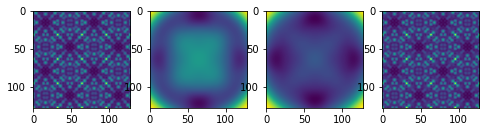

1
Log loss is:  127.32268045219281
Input RMS is:  3.1662726493087376


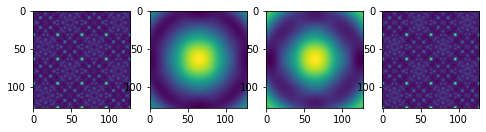

2
Log loss is:  235.04244803053336
Input RMS is:  27.758086643851566


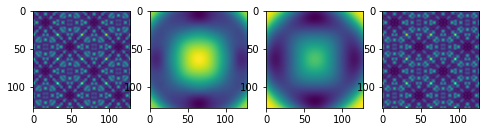

3
Log loss is:  121.19965160357317
Input RMS is:  4.535979497017976


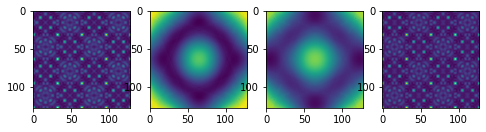

4
Log loss is:  20.902404732984525
Input RMS is:  3.417281993799043


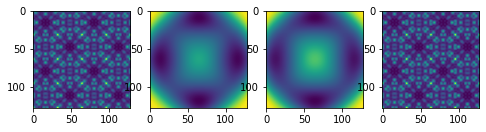

5
Log loss is:  62.16070818963699
Input RMS is:  16.59259027890667


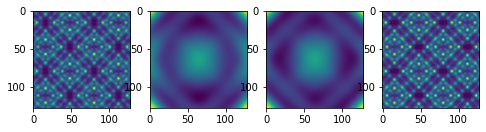

6
Log loss is:  90.8297703504414
Input RMS is:  6.760061894942853


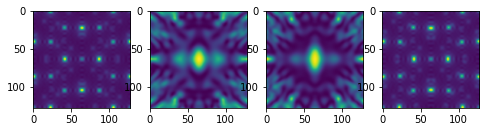

7
Log loss is:  151.7157447294075
Input RMS is:  8.315509692541404


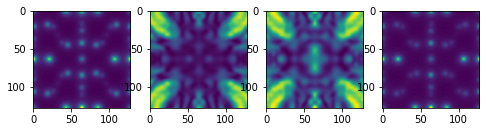

8
Log loss is:  0.0
Input RMS is:  0.0


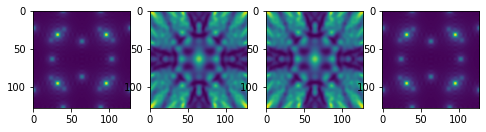

9
Log loss is:  89.89145126161493
Input RMS is:  1.3628835106587667


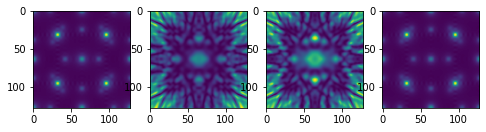

11
Log loss is:  145.01687938767384
Input RMS is:  20.657490201417488


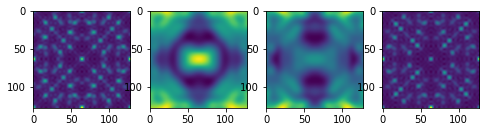

12
Log loss is:  13.549337631323752
Input RMS is:  2.0974224817041023


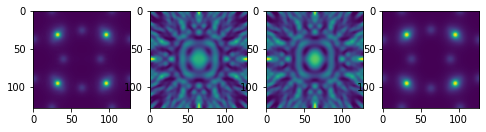

13
Log loss is:  1.5349257498119973
Input RMS is:  0.04669477663268438


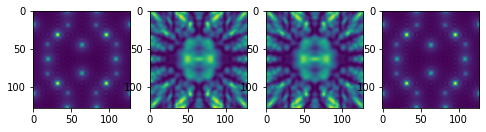

14
Log loss is:  57.4373475629814
Input RMS is:  0.9849576478025349


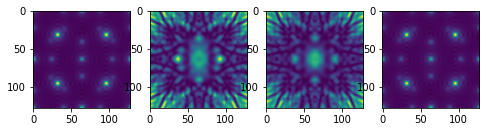

15
Log loss is:  6.193682870379668
Input RMS is:  0.18174702632567752


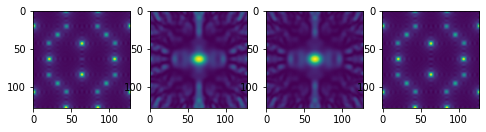

16
Log loss is:  20.937778197385775
Input RMS is:  3.792850585214011


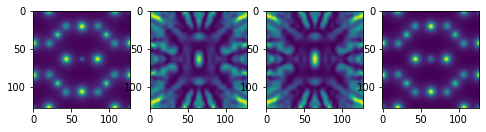

17
Log loss is:  4.013446081155212
Input RMS is:  0.0639092465723275


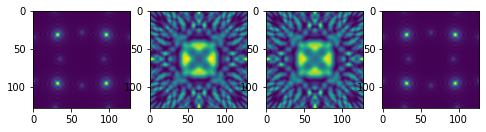

18
Log loss is:  1.5196132499498896
Input RMS is:  0.08882255737871263


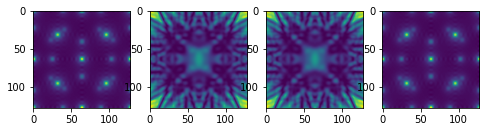

19
Log loss is:  0.0290588529772183
Input RMS is:  0.01910566186321464


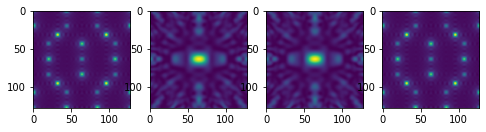

20
Log loss is:  31.27914282107703
Input RMS is:  8.667864282286263


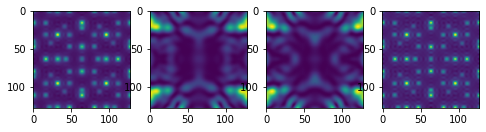

21
Log loss is:  0.0036924610100544978
Input RMS is:  0.0001450119973495653


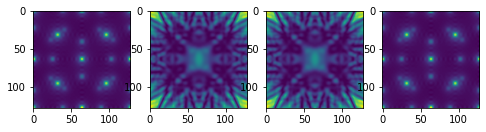

22
Log loss is:  50.390639984914166
Input RMS is:  7.313086697710743


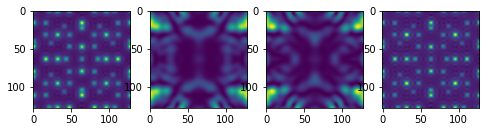

23
Log loss is:  24.528055693366554
Input RMS is:  11.142575503256692


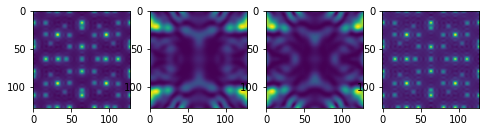

24
Log loss is:  10.931215709359106
Input RMS is:  0.9359477733294362


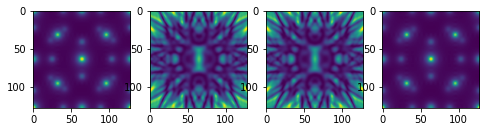

25
Log loss is:  12.781788758472697
Input RMS is:  0.651077875033522


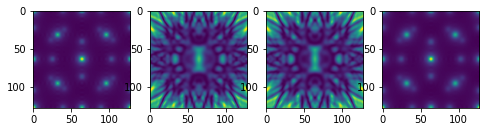

26
Log loss is:  27.810278503709927
Input RMS is:  2.8008338156593924


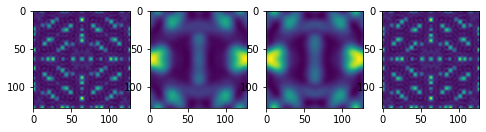

27
Log loss is:  4.3594553429625105
Input RMS is:  0.2936173121790122


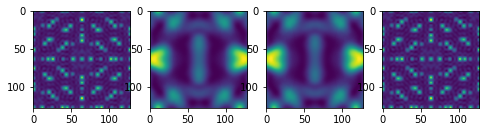

29
Log loss is:  9.133752958479793
Input RMS is:  1.0513072476932896


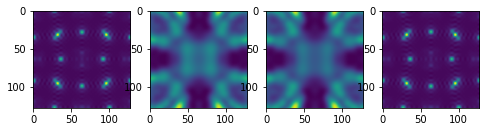

30
Log loss is:  1.122428798582839
Input RMS is:  0.07821742044285009


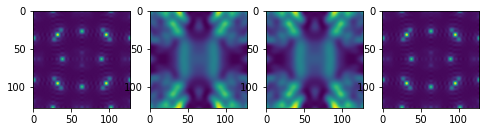

31
Log loss is:  159.60307376545495
Input RMS is:  8.473277458342446


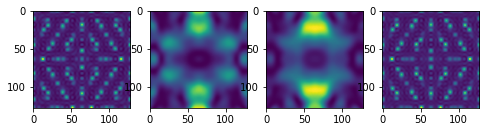

32
Log loss is:  2.888683101652075
Input RMS is:  0.2996368075713533


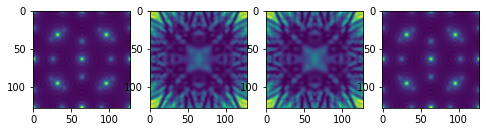

33
Log loss is:  11.218137031454395
Input RMS is:  0.01974941285428189


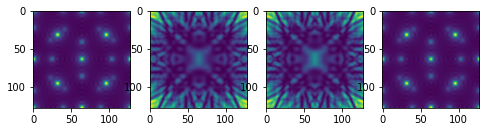

34
Log loss is:  24.262102992028662
Input RMS is:  2.5312622447463906


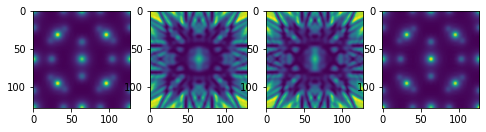

35
Log loss is:  0.14480457233103947
Input RMS is:  0.008500282107374699


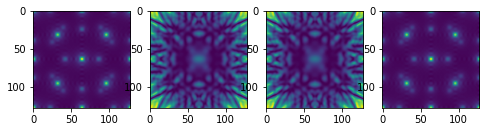

36
Log loss is:  0.019288086910454513
Input RMS is:  0.00023505673572862896


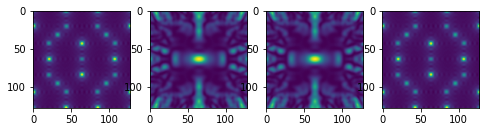

37
Log loss is:  477.2563256216017
Input RMS is:  31.198277653490617


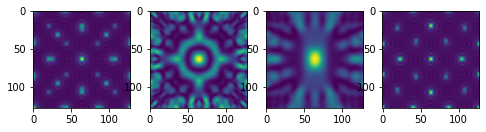

38
Log loss is:  0.13914856045396407
Input RMS is:  0.19402980979257378


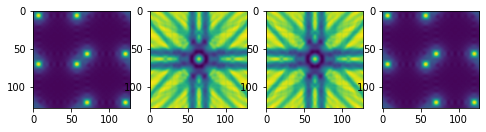

40
Log loss is:  20.797791123569635
Input RMS is:  0.9340567867600457


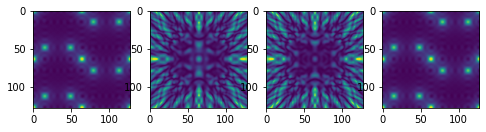

41
Log loss is:  13.311824546998425
Input RMS is:  0.5850383516166977


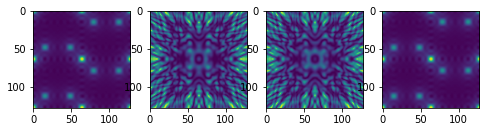

42
Log loss is:  347.6344172648179
Input RMS is:  16.506376875537473


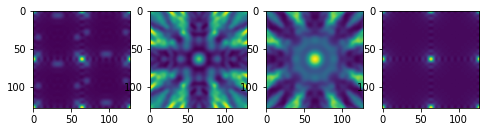

43
Log loss is:  0.05007266758128774
Input RMS is:  0.05732231323922234


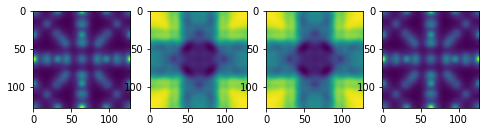

44
Log loss is:  5.650391097545765e-12
Input RMS is:  0.0


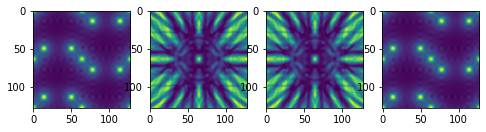

45
Log loss is:  0.013595120462316293
Input RMS is:  0.0005993811107068998


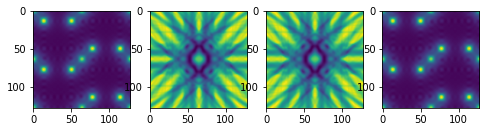

46
Log loss is:  168.26938010941524
Input RMS is:  6.749434471210664


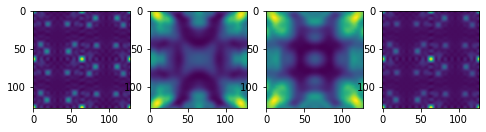

47
Log loss is:  61.84286412843723
Input RMS is:  23.866816235511124


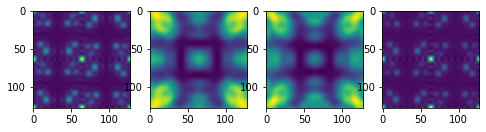

48
Log loss is:  0.3237588932606211
Input RMS is:  0.04697901344840862


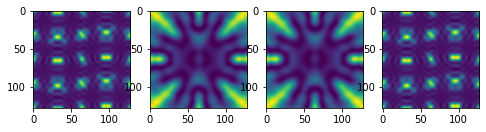

49
Log loss is:  1.9614539326441087
Input RMS is:  0.042528289107395645


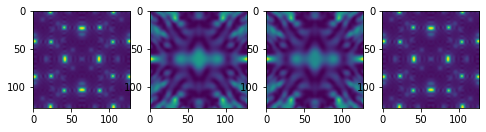

50
Log loss is:  2.5842816507134323
Input RMS is:  0.2301850029916678


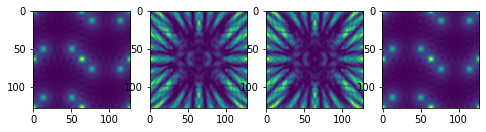

51
Log loss is:  0.005558107189422166
Input RMS is:  2.7248847452199836e-05


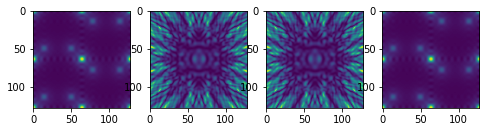

52
Log loss is:  106.94703467677883
Input RMS is:  0.20824985085866424


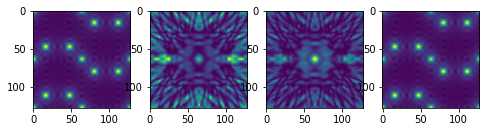

53
Log loss is:  8.0039809152155
Input RMS is:  0.1303185931733106


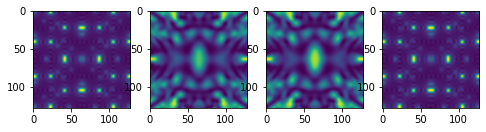

54
Log loss is:  4.541347073432436
Input RMS is:  0.5983553971286901


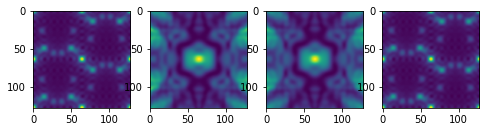

56
Log loss is:  102.37093749871987
Input RMS is:  2.730083656056365


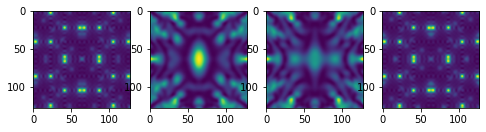

57
Log loss is:  1.1851000019536566
Input RMS is:  0.09127290607154213


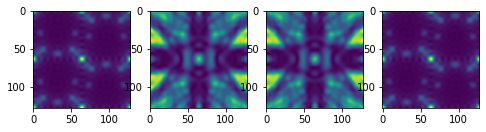

58
Log loss is:  63.927204132393804
Input RMS is:  13.665768824262546


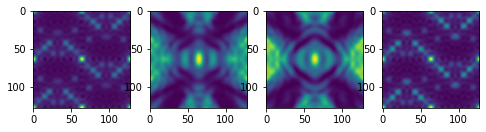

59
Log loss is:  26.714948612728513
Input RMS is:  0.22591050934858406


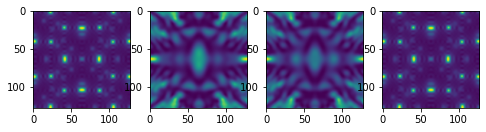

60
Log loss is:  0.012700892881351759
Input RMS is:  3.19730208812417e-05


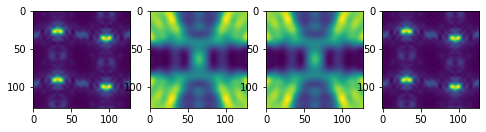

61
Log loss is:  21.849336108511537
Input RMS is:  0.6340360126151133


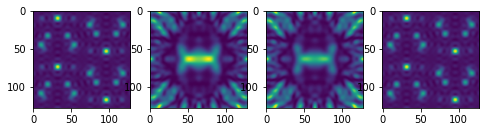

62
Log loss is:  57.03184176499101
Input RMS is:  2.1569012593482193


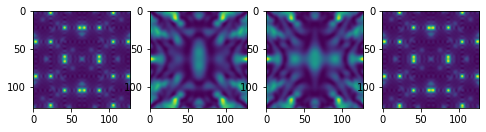

64
Log loss is:  12.021021325713404
Input RMS is:  0.7577795285193717


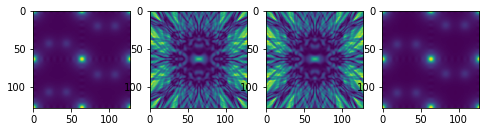

65
Log loss is:  2.6045464820750013
Input RMS is:  18.245615453552617


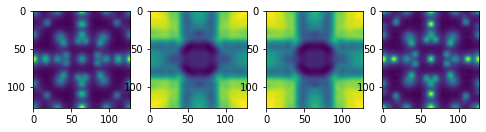

67
Log loss is:  226.90625336542897
Input RMS is:  7.36254135838123


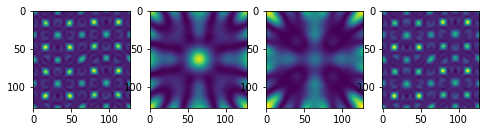

69
Log loss is:  46.81023752698918
Input RMS is:  8.118646836213165


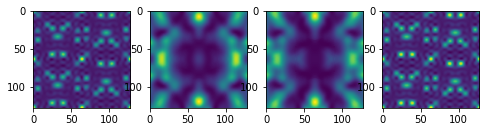

71
Log loss is:  0.29234268888282683
Input RMS is:  0.08021729224954592


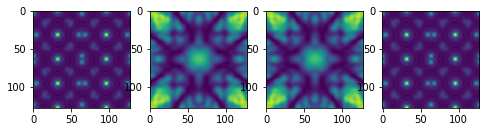

73
Log loss is:  3.291964372011632
Input RMS is:  0.05684018551361024


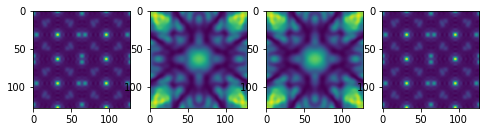

74
Log loss is:  33.562385148408026
Input RMS is:  1.3926145931757061


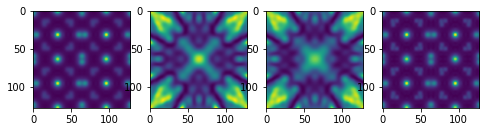

75
Log loss is:  274.841430532416
Input RMS is:  1.2405837266939777


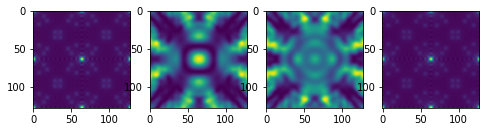

76
Log loss is:  39.79409290185439
Input RMS is:  0.6100546037539296


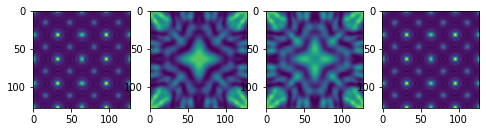

77
Log loss is:  0.2032170866622161
Input RMS is:  0.0015470152253357337


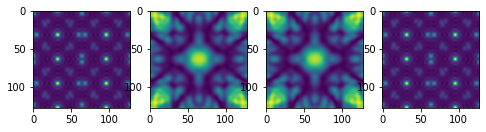

78
Log loss is:  0.0793831474730212
Input RMS is:  0.004020812102481888


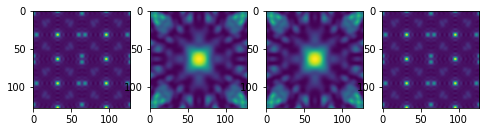

79
Log loss is:  44.826993823703035
Input RMS is:  0.2189614798232055


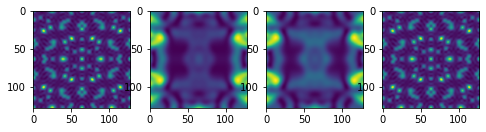

80
Log loss is:  542.1775056571128
Input RMS is:  1.6010343738739348


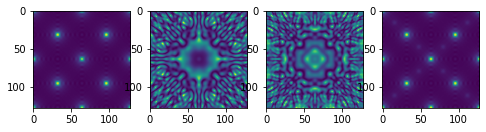

81
Log loss is:  0.11959840289782003
Input RMS is:  0.009691230646848854


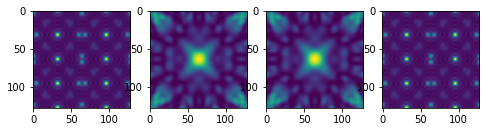

82
Log loss is:  84.62528397572554
Input RMS is:  2.4566042911157178


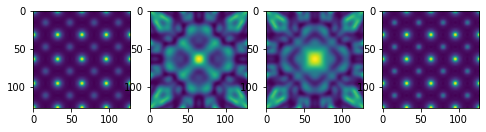

83
Log loss is:  224.17904519042898
Input RMS is:  17.445768301679294


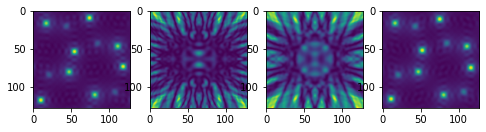

84
Log loss is:  1.4545536787100088
Input RMS is:  0.04784097426444343


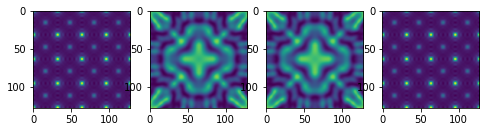

85
Log loss is:  0.881923561379333
Input RMS is:  0.14337413842262572


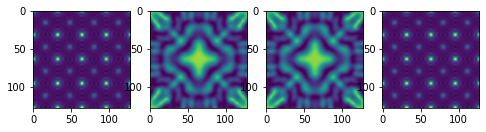

86
Log loss is:  3.1038434680171547
Input RMS is:  0.5281695896146023


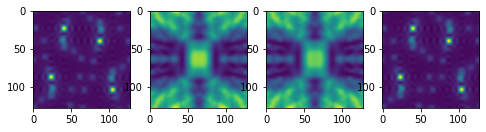

87
Log loss is:  18.196687557259725
Input RMS is:  0.5750268542929874


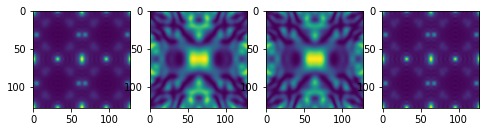

88
Log loss is:  0.5424486523007
Input RMS is:  2.3889667264853904


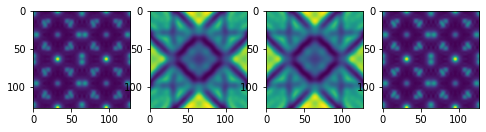

89
Log loss is:  26.5557532188404
Input RMS is:  0.20113410638481932


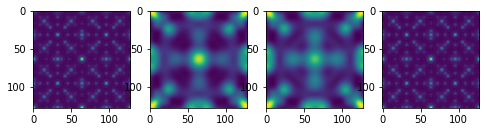

90
Log loss is:  916.0146519300905
Input RMS is:  23.948956459091253


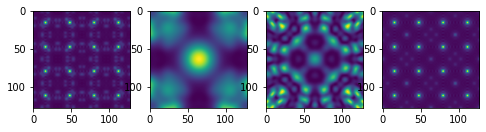

91
Log loss is:  25.899369045198526
Input RMS is:  18.560293717515233


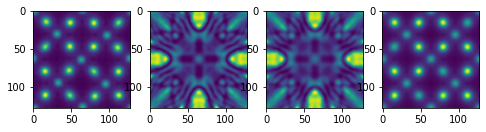

92
Log loss is:  76.44108407041553
Input RMS is:  12.823657408783703


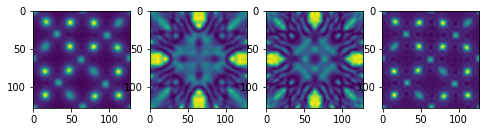

93
Log loss is:  0.25396256419662483
Input RMS is:  0.0006415565982196232


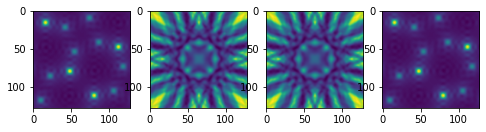

94
Log loss is:  8.915063522756
Input RMS is:  5.994863095480248


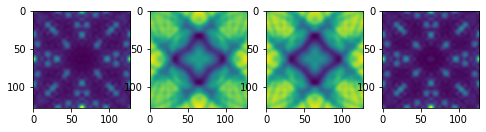

95
Log loss is:  5.035398055849993
Input RMS is:  0.340671040041247


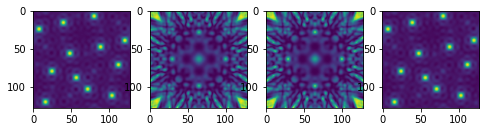

96
Log loss is:  32.064949295238314
Input RMS is:  10.423374641013801


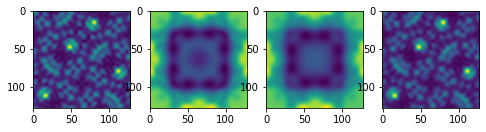

97
Log loss is:  2.490818453406026
Input RMS is:  2.7143374835279297


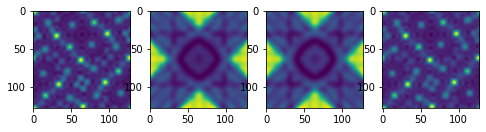

98
Log loss is:  437.93346690495014
Input RMS is:  10.432451348305987


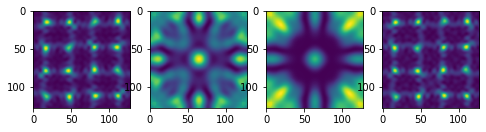

99
Log loss is:  7.28926754015924
Input RMS is:  0.7413528078687508


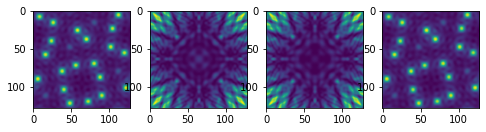

100
Log loss is:  1.6569969573121386
Input RMS is:  0.08116623792314444


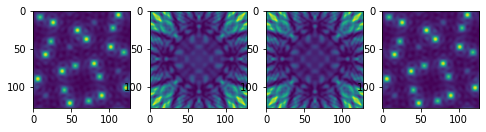

101
Log loss is:  0.606403194697929
Input RMS is:  0.13664948619679437


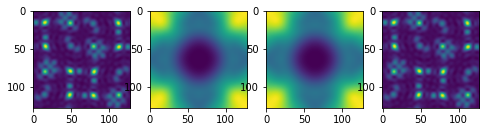

102
Log loss is:  0.3927444973734166
Input RMS is:  0.18330773683303328


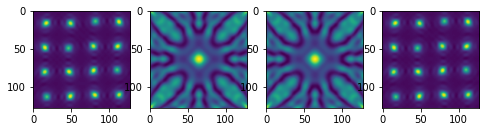

103
Log loss is:  16.80736396724315
Input RMS is:  6.566350697726205


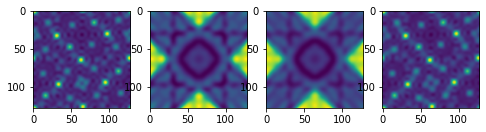

104
Log loss is:  0.015037736588476543
Input RMS is:  0.008585677325204167


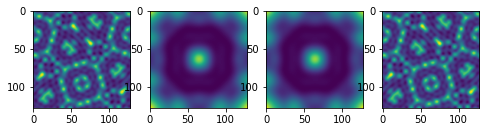

105
Log loss is:  0.0477183452968706
Input RMS is:  0.04048825152531474


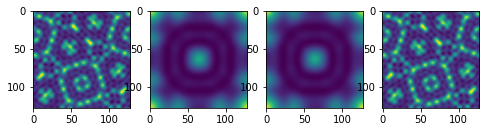

106
Log loss is:  105.5187593535723
Input RMS is:  23.641343742109093


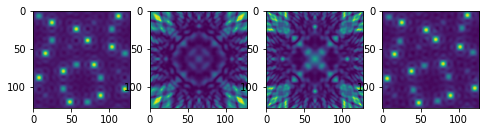

107
Log loss is:  0.012692046085934309
Input RMS is:  5.083036214680613e-07


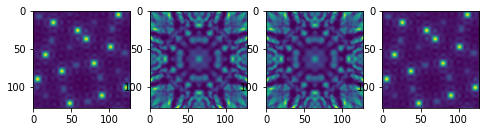

108
Log loss is:  57.167080716191684
Input RMS is:  0.11947895425061249


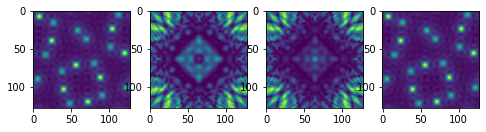

109
Log loss is:  48.31261607303556
Input RMS is:  3.6211568445580276


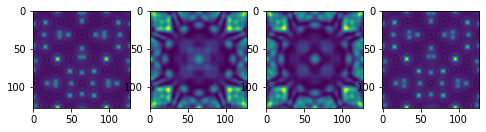

110
Log loss is:  164.07669942378521
Input RMS is:  0.7796559590048273


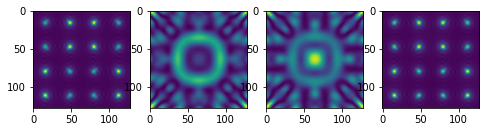

111
Log loss is:  20.004823062211337
Input RMS is:  0.3096886791311237


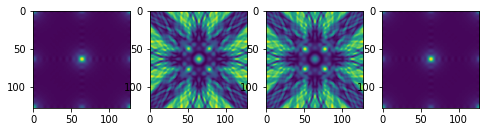

114
Log loss is:  85.59581197504222
Input RMS is:  1.706245592486564


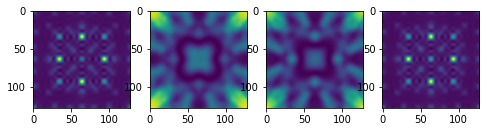

115
Log loss is:  32.57914963717501
Input RMS is:  4.4626057602300495


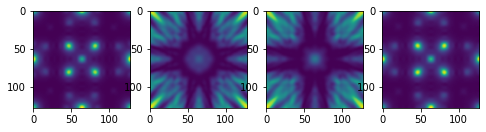

116
Log loss is:  24.082403409079955
Input RMS is:  5.099441637333947


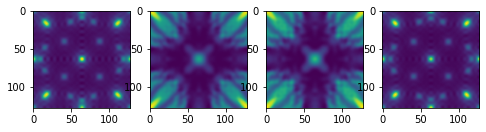

117
Log loss is:  82.50641996483752
Input RMS is:  6.6835165783834105


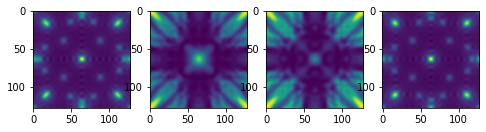

119
Log loss is:  13.012875274976325
Input RMS is:  2.895741938873175


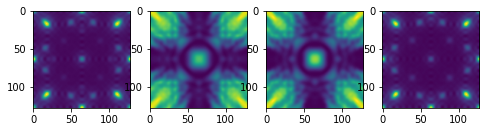

120
Log loss is:  49.38246233527184
Input RMS is:  5.099620223333754


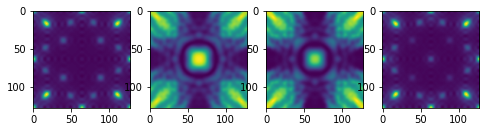

121
Log loss is:  8.082086001203974
Input RMS is:  0.06638200671296281


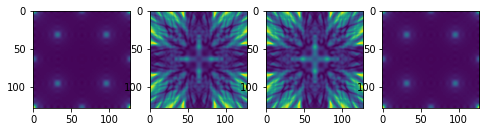

122
Log loss is:  0.007731004392836719
Input RMS is:  5.191246921498989e-06


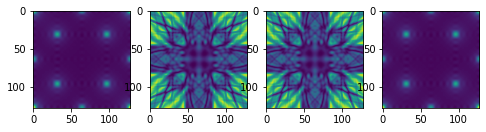

123
Log loss is:  0.0038238227709226896
Input RMS is:  1.6998126044044061e-06


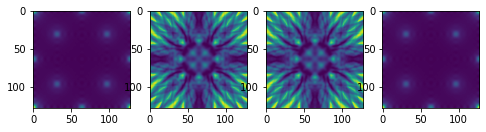

124
Log loss is:  17.88520901249407
Input RMS is:  0.4656485621430186


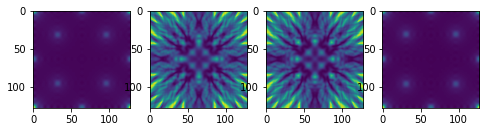

125
Log loss is:  38.57358737441359
Input RMS is:  0.34986044184827453


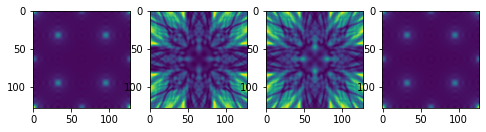

126
Log loss is:  23.852046306017037
Input RMS is:  1.3923034273706905


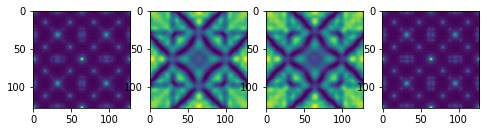

127
Log loss is:  782.0454095609253
Input RMS is:  0.14388810224379942


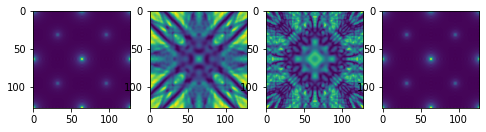

128
Log loss is:  19.48116516916034
Input RMS is:  1.124242598274386


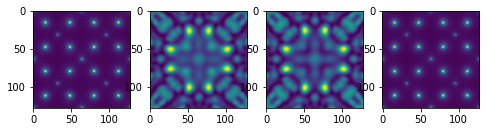

129
Log loss is:  1033.2478276005972
Input RMS is:  3.951103098752184


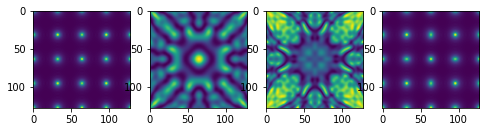

130
Log loss is:  196.91699928744777
Input RMS is:  31.494105269172497


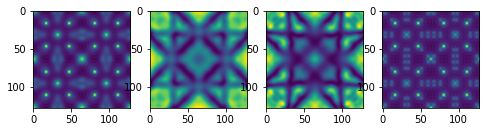

133
Log loss is:  3.2994501218256937
Input RMS is:  0.22478315287689224


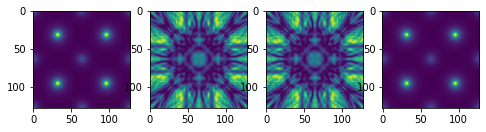

134
Log loss is:  159.14026345851033
Input RMS is:  3.0299721521340963


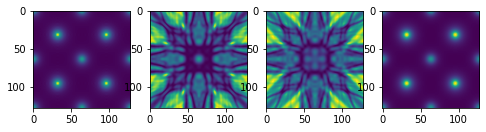

135
Log loss is:  3.5567831211723457
Input RMS is:  2.8947661808139378


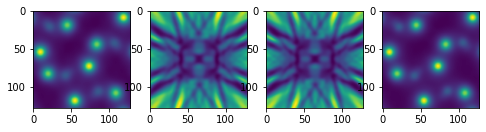

136
Log loss is:  0.0
Input RMS is:  0.0


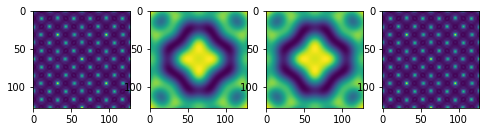

137
Log loss is:  89.91848339310097
Input RMS is:  18.48056248497766


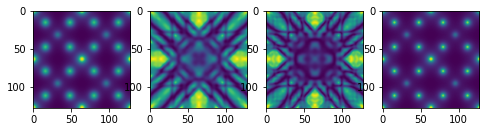

138
Log loss is:  0.7774732129593349
Input RMS is:  0.0010582979600450653


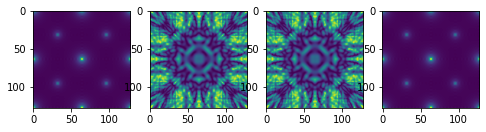

139
Log loss is:  0.013412122900192006
Input RMS is:  2.7261839635352683e-06


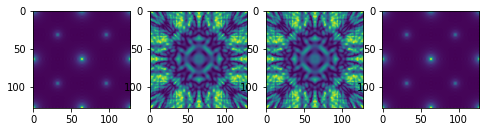

140
Log loss is:  22.993352904215485
Input RMS is:  3.7868064849957372


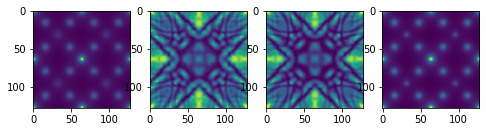

141
Log loss is:  0.34663312644623534
Input RMS is:  0.03932832602869739


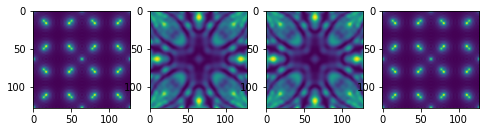

142
Log loss is:  7.0662147603859395
Input RMS is:  0.20986987368566426


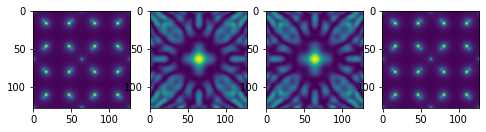

143
Log loss is:  0.439066694446272
Input RMS is:  0.07380515554076439


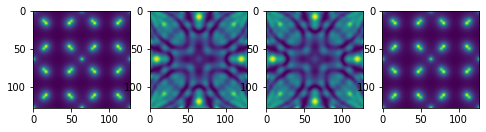

144
Log loss is:  10.092609985779012
Input RMS is:  0.00244919849866281


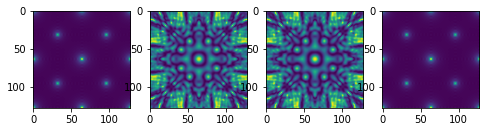

145
Log loss is:  405.31723511325737
Input RMS is:  11.742612614924473


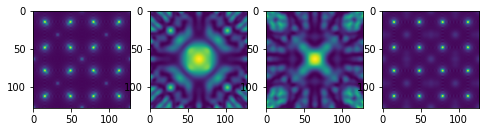

146
Log loss is:  651.7642397572138
Input RMS is:  6.017390109653363e-11


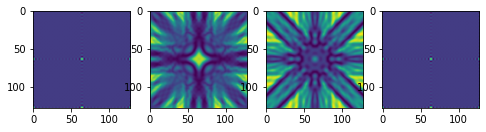

147
Log loss is:  125.76238744673607
Input RMS is:  35.701044249318684


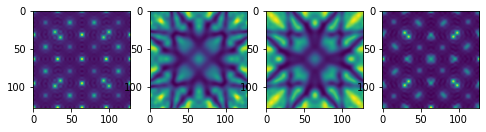

148
Log loss is:  66.96352194645586
Input RMS is:  8.889242473017037


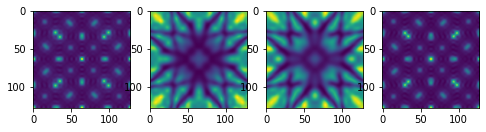

149
Log loss is:  283.6591503988424
Input RMS is:  3.910468935025958


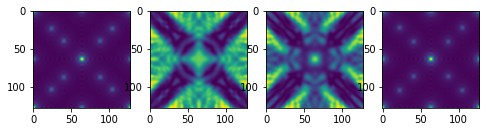

150
Log loss is:  38.48899440290896
Input RMS is:  16.021823320516614


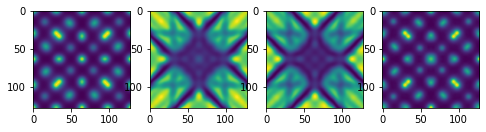

151
Log loss is:  10.705855865110005
Input RMS is:  0.9370626355148461


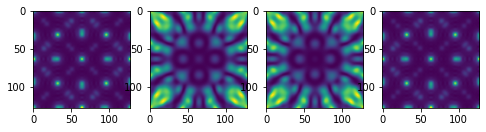

152
Log loss is:  1.6542439992885019
Input RMS is:  0.8177061087914897


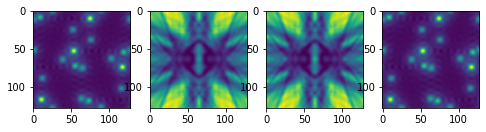

153
Log loss is:  64.97424733652873
Input RMS is:  12.603473321597198


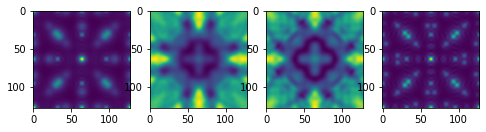

154
Log loss is:  317.55494112672943
Input RMS is:  28.53953308351193


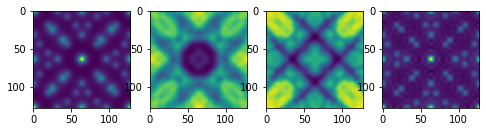

155
Log loss is:  46.47535504669923
Input RMS is:  9.431282805890556


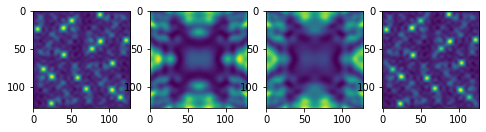

156
Log loss is:  750.9407947263456
Input RMS is:  14.30148789505845


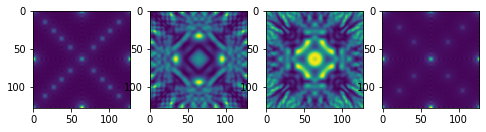

157
Log loss is:  0.22977534426757823
Input RMS is:  0.08442633785147644


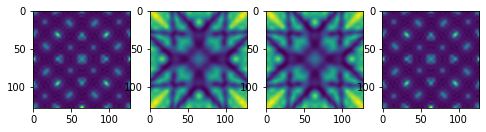

158
Log loss is:  1.302105670883305
Input RMS is:  0.44703757651170534


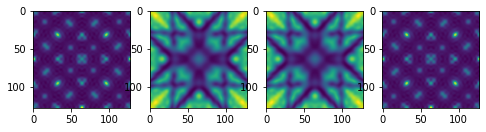

159
Log loss is:  29.834677189991
Input RMS is:  8.371216244514724


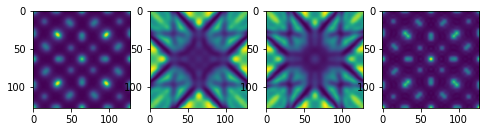

160
Log loss is:  2.3133501609989
Input RMS is:  0.6132048631406914


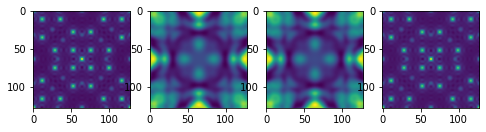

161
Log loss is:  4.701347638058736
Input RMS is:  7.177735429414476


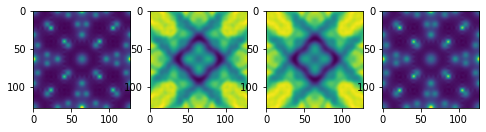

162
Log loss is:  953.6756376608386
Input RMS is:  30.001117369518155


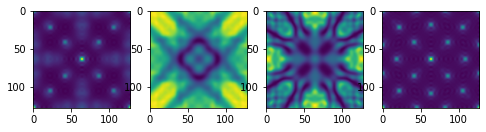

163
Log loss is:  7.2363484641725595
Input RMS is:  0.3702346586051922


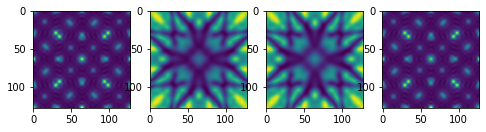

164
Log loss is:  0.06144480234270344
Input RMS is:  0.00647205756984112


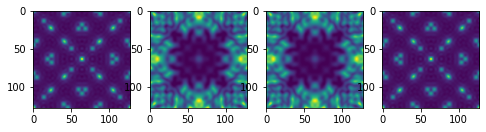

165
Log loss is:  1.201559687541287
Input RMS is:  0.047953377191054844


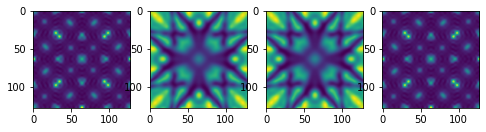

166
Log loss is:  0.20697285757189224
Input RMS is:  0.020779194446169377


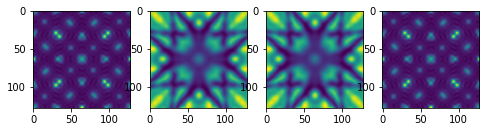

167
Log loss is:  1.364390448933489
Input RMS is:  0.6196202787914161


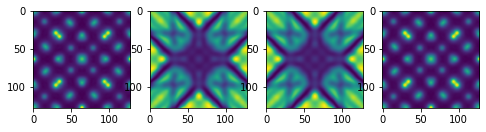

168
Log loss is:  516.223062575602
Input RMS is:  6.396347905074202


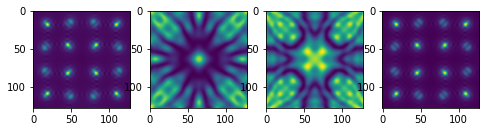

169
Log loss is:  672.4822086281312
Input RMS is:  26.33931147224974


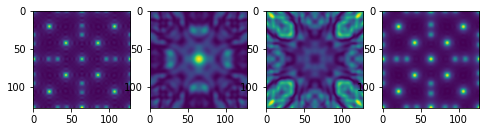

170
Log loss is:  1.39896018929767
Input RMS is:  0.023574841002162877


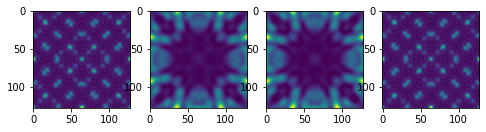

171
Log loss is:  0.12028040605385863
Input RMS is:  0.011308356486983051


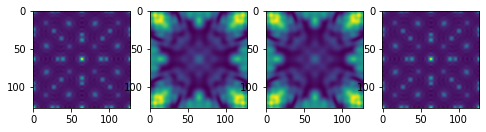

172
Log loss is:  15.076776772936212
Input RMS is:  4.088059065804341


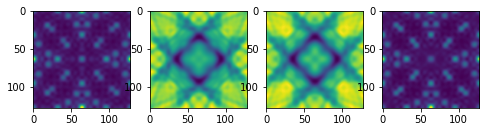

173
Log loss is:  41.488012901703776
Input RMS is:  0.9853010375846568


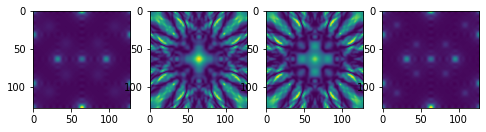

174
Log loss is:  5.265301639019932
Input RMS is:  1.397643406186149


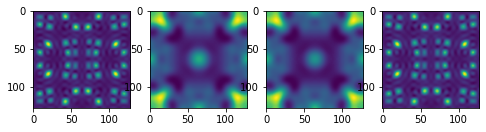

175
Log loss is:  4.009540232802957
Input RMS is:  2.983286129783837


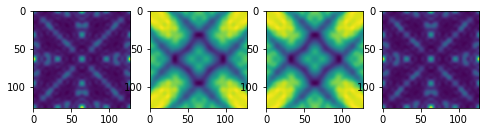

176
Log loss is:  189.32483988796952
Input RMS is:  14.790985594600011


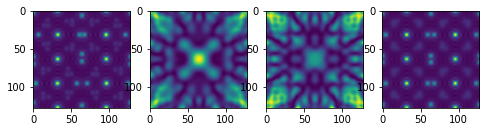

177
Log loss is:  2.024349596770317
Input RMS is:  0.621537251946158


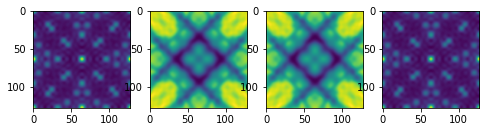

178
Log loss is:  0.19579629249908723
Input RMS is:  0.07429882582537756


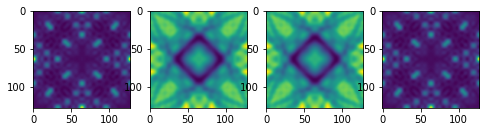

179
Log loss is:  2.9154611055949045
Input RMS is:  0.15248048181605817


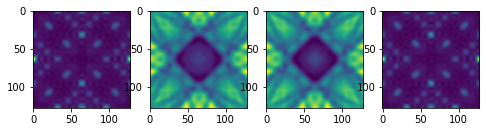

180
Log loss is:  5.7312954681251425
Input RMS is:  2.650754333610859


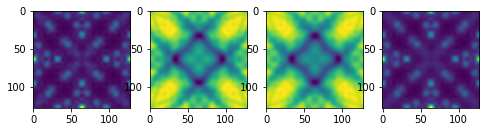

181
Log loss is:  53.80752081853606
Input RMS is:  1.7586441315581423


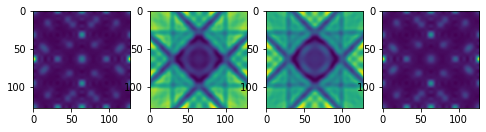

182
Log loss is:  2.8211005394201156
Input RMS is:  4.670124609576951


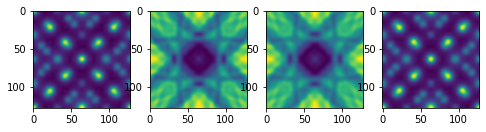

183
Log loss is:  0.015276821006328463
Input RMS is:  0.009639727617070434


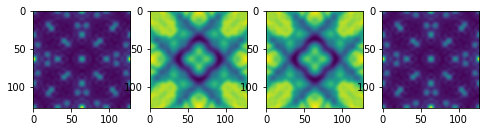

184
Log loss is:  1006.5638099255269
Input RMS is:  3.9666929678147786


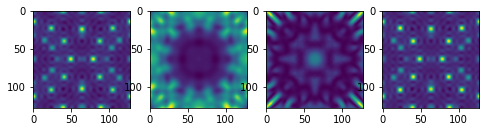

185
Log loss is:  178.15754241852758
Input RMS is:  1.1981212640382828


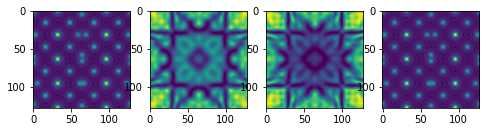

187
Log loss is:  0.1918343619999265
Input RMS is:  0.15356461653097442


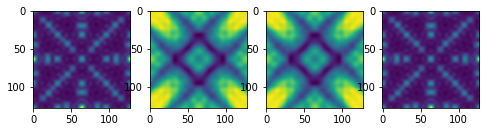

188
Log loss is:  0.10865812880432535
Input RMS is:  0.06812264028888952


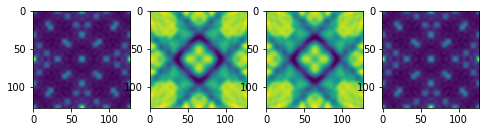

189
Log loss is:  0.7937473611248976
Input RMS is:  0.31922517349922735


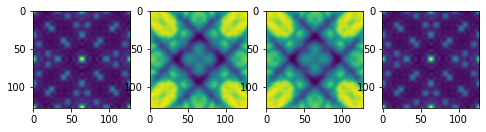

190
Log loss is:  0.4991834528685555
Input RMS is:  0.09908122882831363


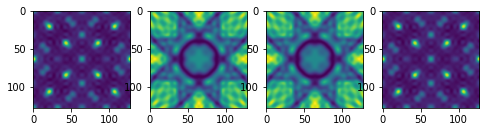

191
Log loss is:  0.0776882378038057
Input RMS is:  0.02280969065066804


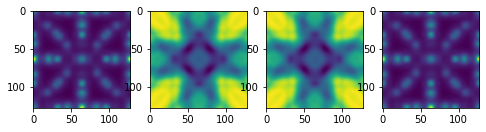

192
Log loss is:  17.62968075087219
Input RMS is:  2.8463990404308066


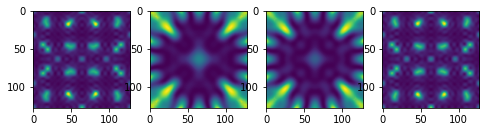

193
Log loss is:  330.85669202587127
Input RMS is:  14.064846704981655


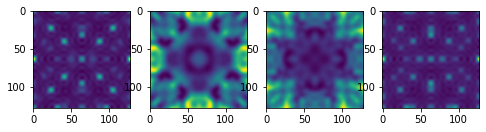

194
Log loss is:  1.3291666291662259
Input RMS is:  1.2272479837862393


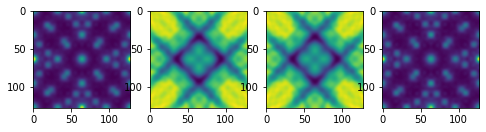

195
Log loss is:  0.23527732316870528
Input RMS is:  0.2737124526502572


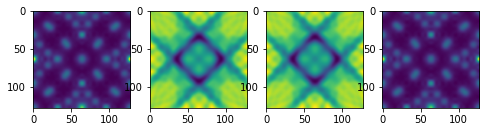

196
Log loss is:  0.2847204397808734
Input RMS is:  0.06859035743506134


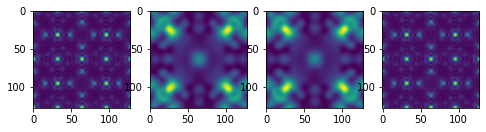

197
Log loss is:  0.05939326450719326
Input RMS is:  0.12505201439328184


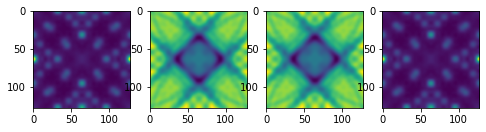

198
Log loss is:  0.1455386239835203
Input RMS is:  0.00025024450951826937


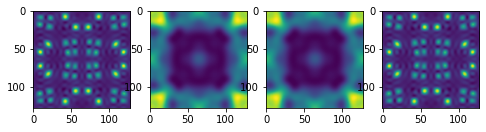

199
Log loss is:  2.9640263876388797
Input RMS is:  2.888355456248822


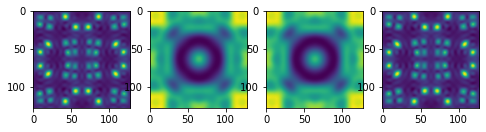

200
Log loss is:  0.27613971771476453
Input RMS is:  0.005091221555239506


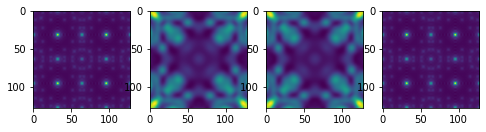

201
Log loss is:  1.743848017128937
Input RMS is:  0.00622461540454914


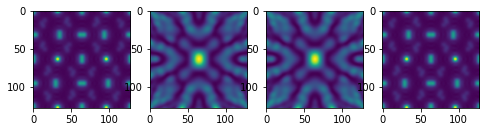

202
Log loss is:  0.12724279383154538
Input RMS is:  0.004672849415421043


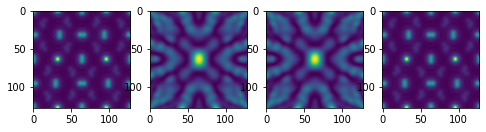

203
Log loss is:  938.0914988924405
Input RMS is:  0.467443236811712


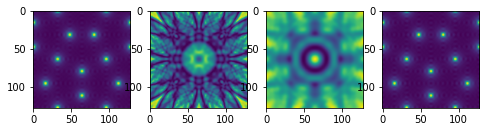

204
Log loss is:  5.860366934042742
Input RMS is:  3.145035376103463


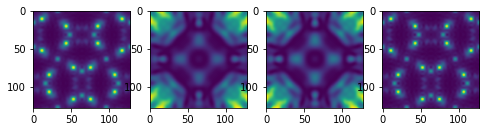

205
Log loss is:  86.47762903376179
Input RMS is:  9.92046161261248


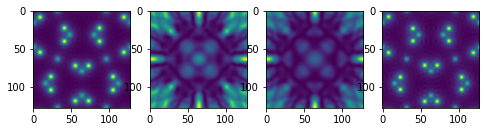

206
Log loss is:  1469.0959702492128
Input RMS is:  24.442264318558173


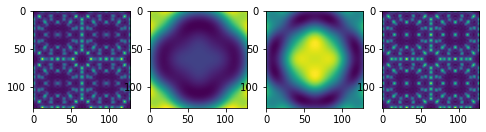

207
Log loss is:  844.156434006655
Input RMS is:  15.845015113285925


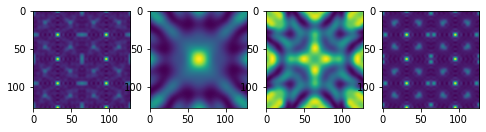

208
Log loss is:  26.000978466909682
Input RMS is:  3.3831558953865977


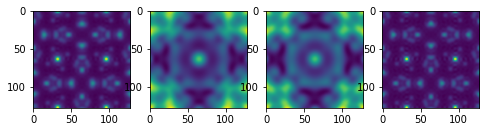

209
Log loss is:  1.6820672158895975
Input RMS is:  0.009999434923863812


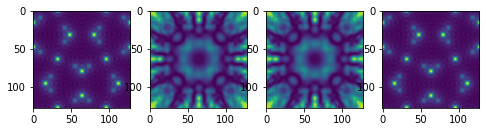

210
Log loss is:  168.49154273231213
Input RMS is:  45.503066875517966


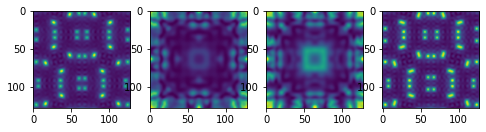

211
Log loss is:  54.70173040261497
Input RMS is:  2.629800373787767


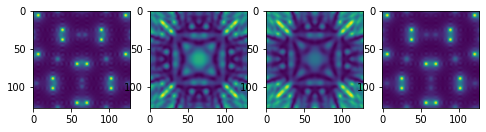

212
Log loss is:  2.1592114675958376
Input RMS is:  2.7221187703608347


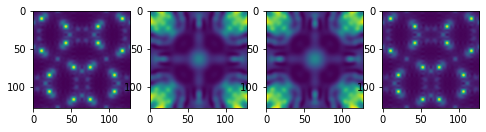

213
Log loss is:  174.16924301571092
Input RMS is:  5.895484580757538


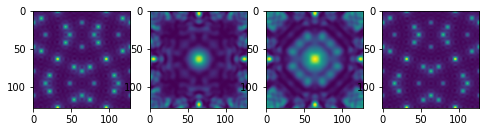

214
Log loss is:  145.85930883832847
Input RMS is:  18.16288294069759


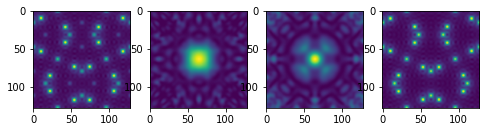

215
Log loss is:  825.2208292865532
Input RMS is:  22.060493096013115


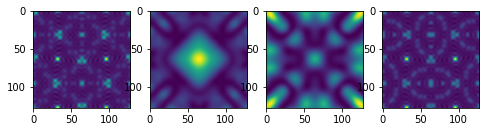

216
Log loss is:  1.443841414307408
Input RMS is:  0.038148220556009124


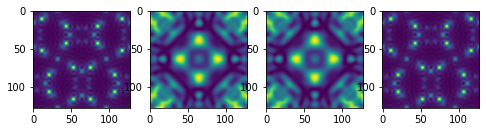

217
Log loss is:  1.1890491786288369
Input RMS is:  0.2395349169638394


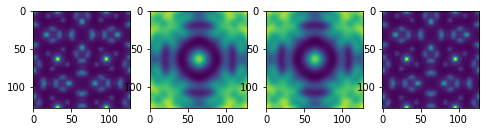

218
Log loss is:  0.038017090439662754
Input RMS is:  6.87931148634257e-06


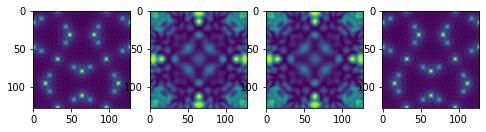

219
Log loss is:  0.04183238531623194
Input RMS is:  0.1626956428449519


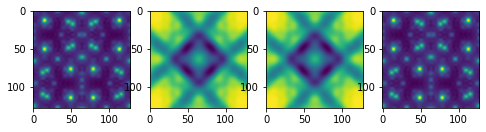

220
Log loss is:  180.0229468650905
Input RMS is:  0.3416380342672634


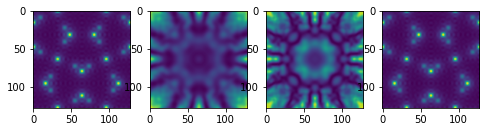

221
Log loss is:  252.24290739265777
Input RMS is:  0.1471637183069761


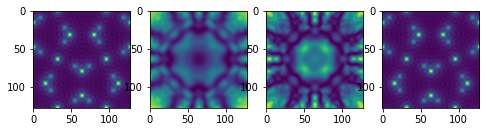

223
Log loss is:  47.8415775284945
Input RMS is:  5.98230192046979


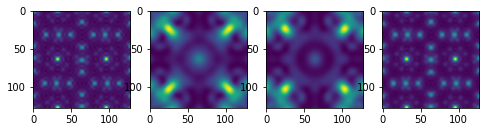

224
Log loss is:  4.622373508053576
Input RMS is:  0.5796844378350575


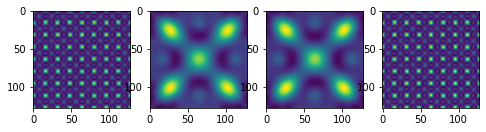

225
Log loss is:  5.675580461040759
Input RMS is:  3.122705789624057


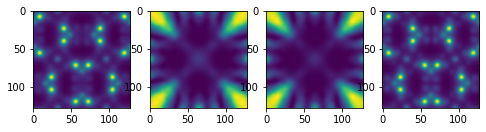

226
Log loss is:  283.3586837224879
Input RMS is:  15.976688707509645


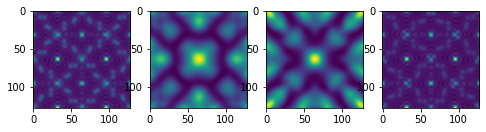

227
Log loss is:  24.08902329324612
Input RMS is:  4.487577530545553


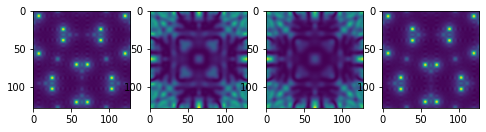

228
Log loss is:  0.2166095275737199
Input RMS is:  0.03446074330614468


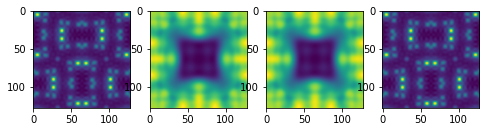

229
Log loss is:  0.03131547906254346
Input RMS is:  0.0040971099309505985


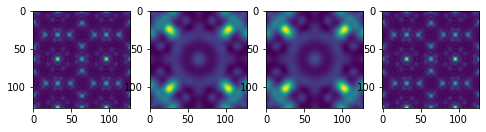

230
Log loss is:  67.48564552410079
Input RMS is:  3.545274347741112


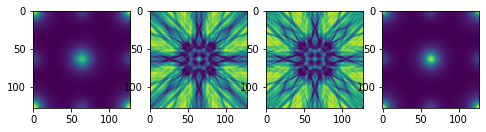

231
Log loss is:  1.159507101382556
Input RMS is:  8.348863928318277


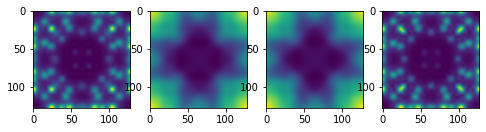

232
Log loss is:  3.1483055963067725
Input RMS is:  9.598327043172723


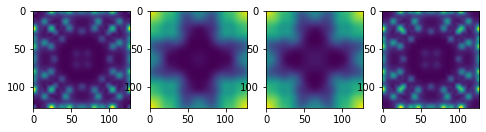

233
Log loss is:  34.61666963143564
Input RMS is:  12.341980123886733


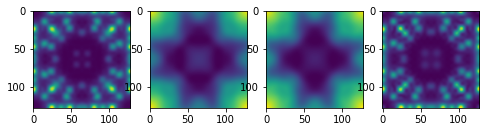

234
Log loss is:  10.043888852014986
Input RMS is:  0.768632751220872


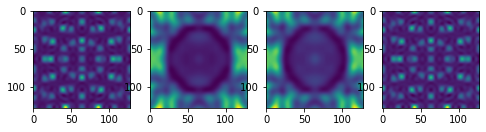

235
Log loss is:  191.00352572668467
Input RMS is:  44.91331910592381


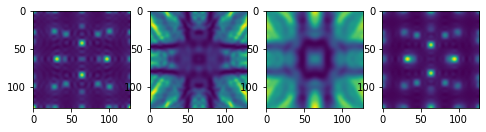

236
Log loss is:  5.415457165033141
Input RMS is:  0.606109686481823


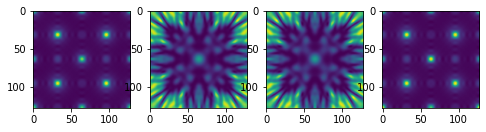

237
Log loss is:  20.791751693517803
Input RMS is:  0.5251168438630649


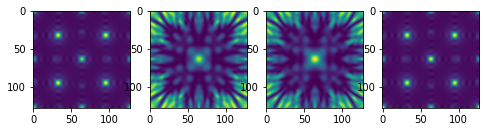

239
Log loss is:  0.22389941932768026
Input RMS is:  0.00022515972558789817


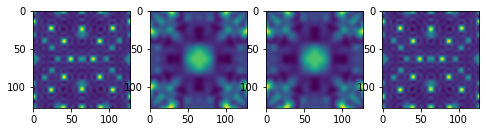

240
Log loss is:  0.0
Input RMS is:  0.0


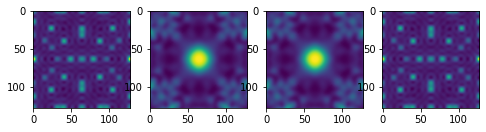

241
Log loss is:  28.542053790017118
Input RMS is:  12.582856715083151


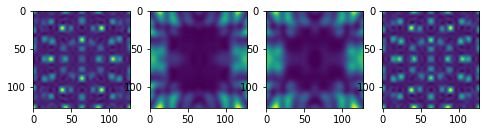

242
Log loss is:  489.93618944184755
Input RMS is:  33.46595899402254


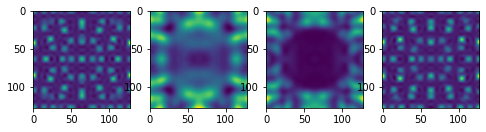

243
Log loss is:  0.1698743711996731
Input RMS is:  0.00547014979269915


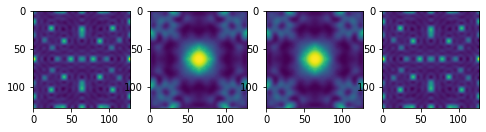

244
Log loss is:  0.012488307908933467
Input RMS is:  0.00012830380869853158


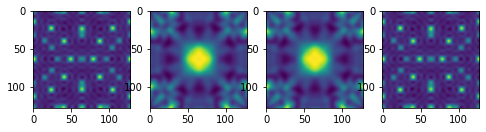

245
Log loss is:  159.58232268534053
Input RMS is:  6.063679146106791


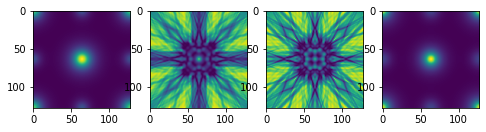

246
Log loss is:  0.9391088375624352
Input RMS is:  0.004723553489622389


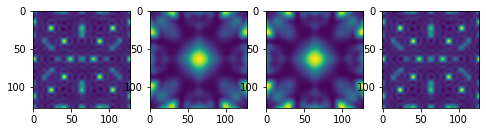

247
Log loss is:  48.3297464779382
Input RMS is:  4.008561623138327


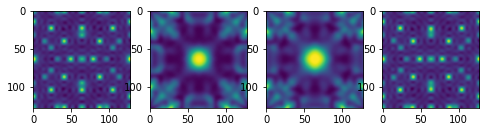

248
Log loss is:  0.05511182722489823
Input RMS is:  0.00010744646586795348


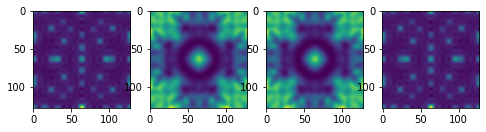

249
Log loss is:  105.76890115311639
Input RMS is:  1.8001535546578646


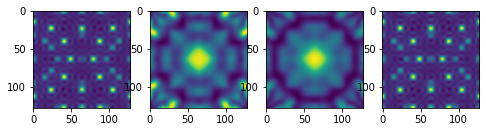

250
Log loss is:  0.006853370658250307
Input RMS is:  4.669294794133518e-05


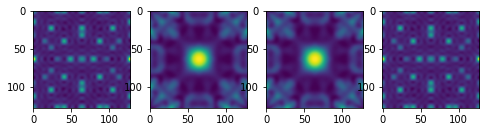

251
Log loss is:  0.018464835498002527
Input RMS is:  0.00017942994562095003


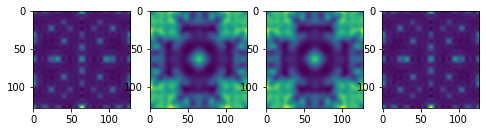

252
Log loss is:  7.832009671341689
Input RMS is:  0.7876874116298046


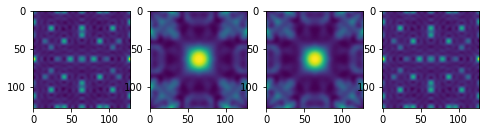

253
Log loss is:  18.101800836884916
Input RMS is:  0.6061427738681333


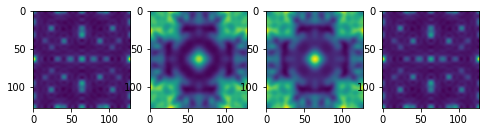

254
Log loss is:  49.239640623531585
Input RMS is:  0.7339150762000674


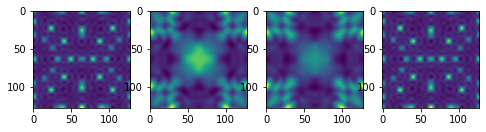

255
Log loss is:  0.11033510362468689
Input RMS is:  0.0020954217293279


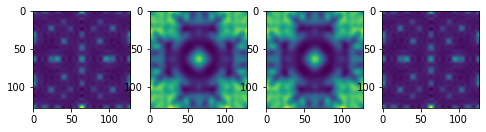

256
Log loss is:  0.15182267948402084
Input RMS is:  0.0003126509241557464


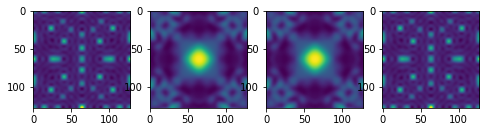

257
Log loss is:  95.43141756873116
Input RMS is:  3.4416758203854556


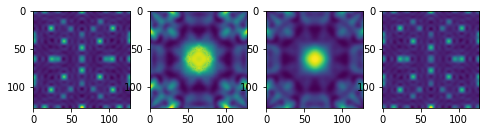

258
Log loss is:  137.0050676122754
Input RMS is:  2.4961358140647647


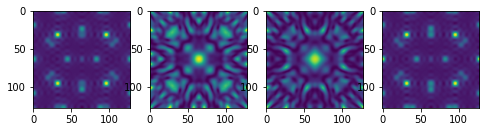

259
Log loss is:  0.8846511962788266
Input RMS is:  0.0662596374451587


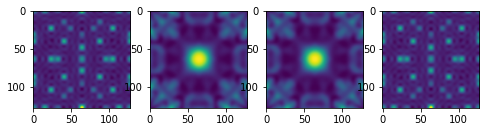

260
Log loss is:  138.12449685257803
Input RMS is:  2.9792686751532846


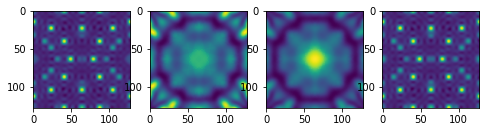

261
Log loss is:  148.33420716330835
Input RMS is:  2.1742989632027467


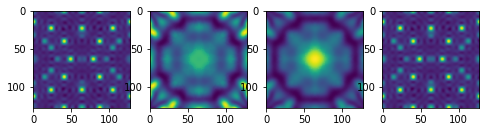

262
Log loss is:  335.55276684320006
Input RMS is:  6.335809262525644


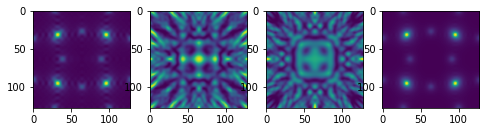

263
Log loss is:  1.0091010986107711
Input RMS is:  0.07831896349794185


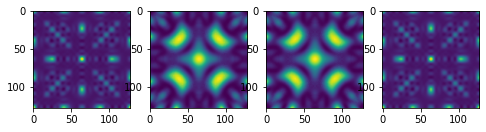

264
Log loss is:  1.769029602861533
Input RMS is:  0.49148178334004067


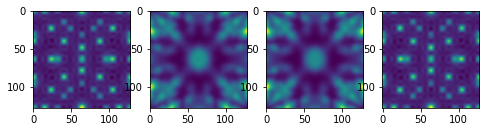

265
Log loss is:  0.06870453003763215
Input RMS is:  0.011451490694268459


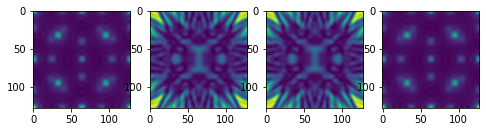

266
Log loss is:  157.07356367238737
Input RMS is:  2.090376767930846


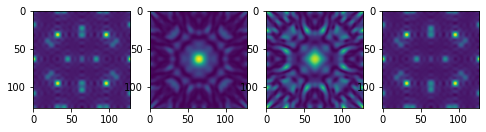

267
Log loss is:  5.99992921655028
Input RMS is:  0.2460659333699288


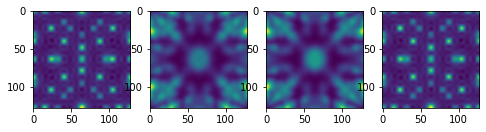

268
Log loss is:  7.152726946465052
Input RMS is:  0.8151513972271681


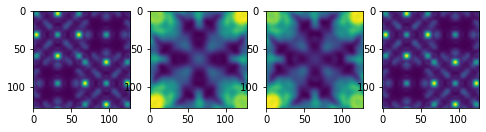

269
Log loss is:  0.23510639454467508
Input RMS is:  0.04835216399876695


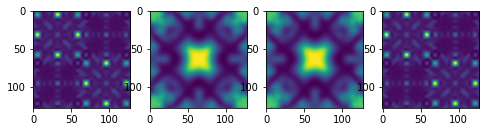

270
Log loss is:  0.07430779832919858
Input RMS is:  2.6711456204999137e-05


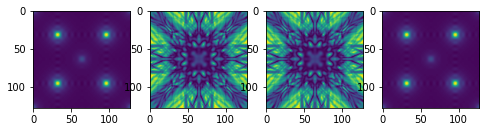

271
Log loss is:  10.058678451238872
Input RMS is:  1.1453852211863558


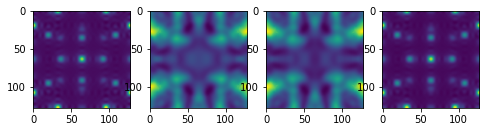

272
Log loss is:  0.0
Input RMS is:  0.0


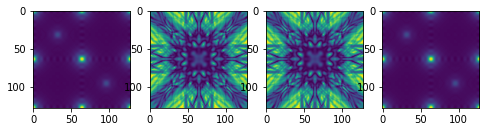

273
Log loss is:  263.00339062386934
Input RMS is:  9.779274465548085


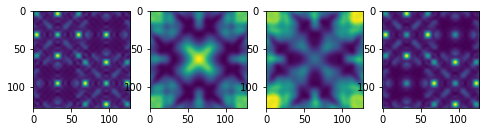

274
Log loss is:  203.52004110591741
Input RMS is:  6.493154478603941


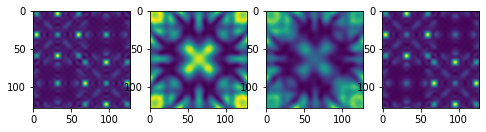

276
Log loss is:  87.52058133047508
Input RMS is:  7.536991787378303


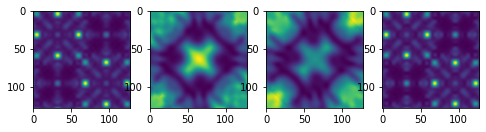

277
Log loss is:  0.16854797533613516
Input RMS is:  0.014415978574688048


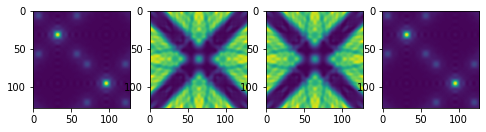

278
Log loss is:  24.34519727361868
Input RMS is:  1.1053578318879687


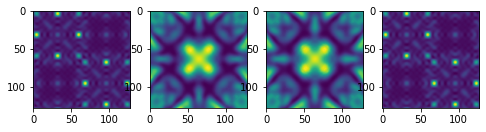

279
Log loss is:  778.1131895222052
Input RMS is:  2.648475833896822


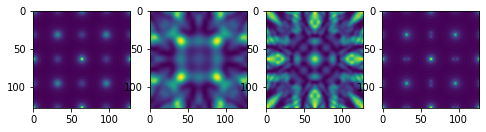

280
Log loss is:  0.5050031989860779
Input RMS is:  0.008564062874183518


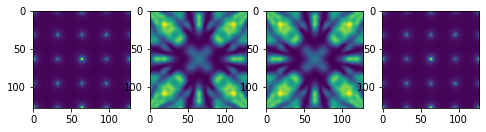

281
Log loss is:  437.57693643927973
Input RMS is:  13.214583468659178


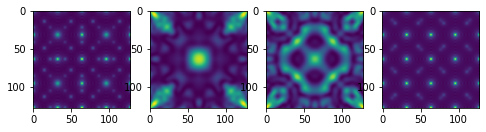

282
Log loss is:  658.9695554313498
Input RMS is:  5.58783994436169


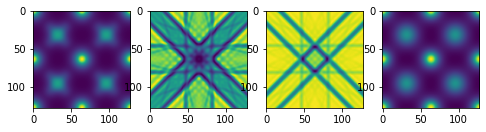

283
Log loss is:  28.441752073182165
Input RMS is:  2.0187227484494836


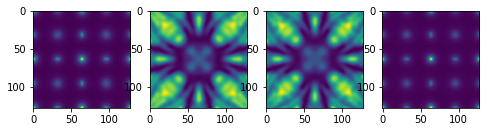

284
Log loss is:  438.3665128986993
Input RMS is:  0.4567933608831626


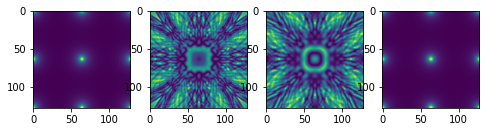

285
Log loss is:  75.71485084686064
Input RMS is:  0.9526431684665164


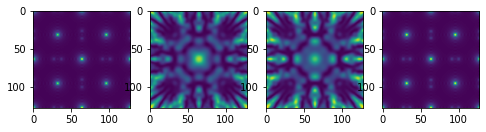

286
Log loss is:  140.3812512290486
Input RMS is:  0.01844556830130556


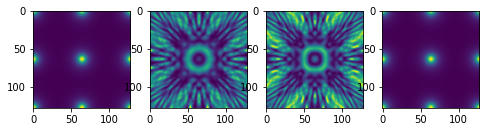

287
Log loss is:  15.481254618161831
Input RMS is:  0.0012235623283042487


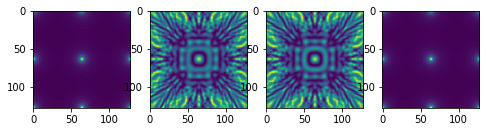

288
Log loss is:  0.06535773123753082
Input RMS is:  0.0011477150793041473


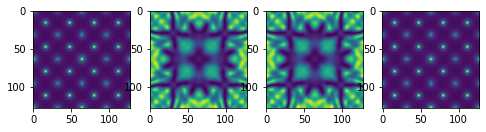

289
Log loss is:  247.39259498858434
Input RMS is:  1.1109077009992905


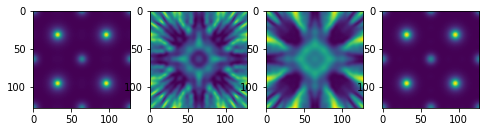

290
Log loss is:  479.13232466522277
Input RMS is:  34.27377355083609


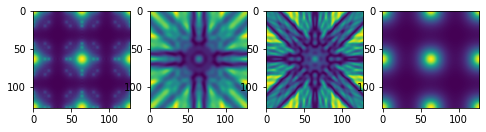

291
Log loss is:  780.0551596936014
Input RMS is:  16.573892885687


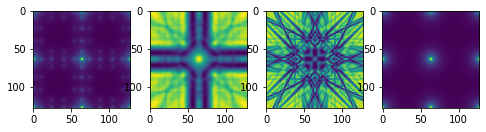

292
Log loss is:  22.631284444013396
Input RMS is:  0.9596835347827648


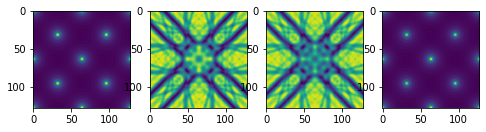

293
Log loss is:  12.845434446731709
Input RMS is:  0.3547276417711843


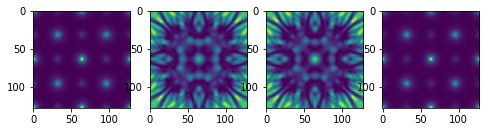

294
Log loss is:  17.896007456716713
Input RMS is:  1.656679731548198


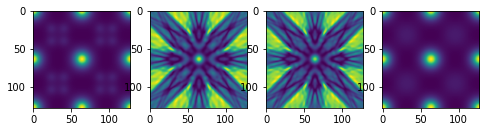

295
Log loss is:  0.049512259397320804
Input RMS is:  0.0006400532791165162


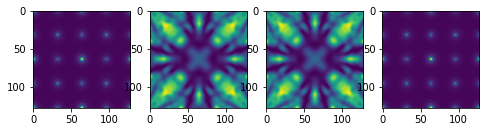

296
Log loss is:  47.57571717126768
Input RMS is:  3.12376355978101


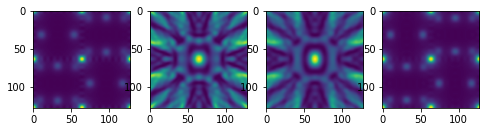

297
Log loss is:  345.2070222749376
Input RMS is:  2.9612494300670775


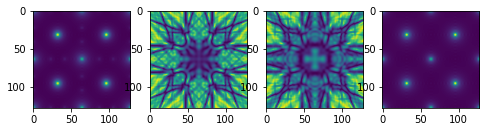

298
Log loss is:  7.394278037758906
Input RMS is:  2.326318323074031


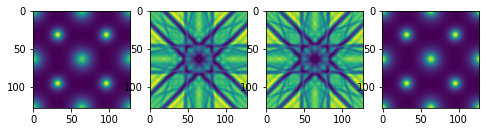

299
Log loss is:  649.2938407091298
Input RMS is:  9.221035214191595


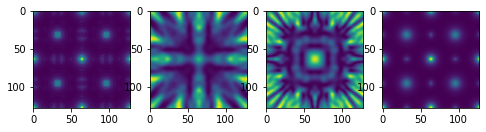

300
Log loss is:  0.09076306045500243
Input RMS is:  0.019781905298012867


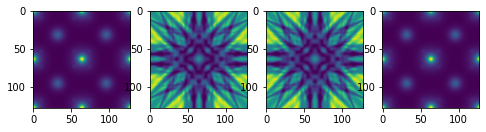

301
Log loss is:  1.4388501776928235
Input RMS is:  0.011584398300141144


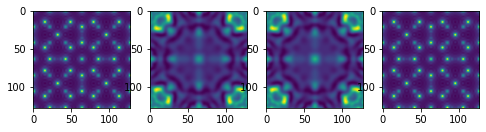

302
Log loss is:  0.7117559560605402
Input RMS is:  0.025552525634277776


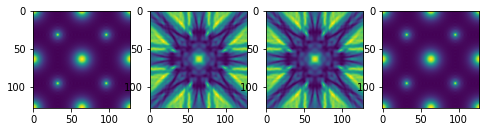

303
Log loss is:  1.2196371456667592
Input RMS is:  1.227894274109658


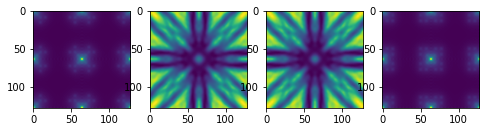

304
Log loss is:  0.6082402066357615
Input RMS is:  0.0013341364667258419


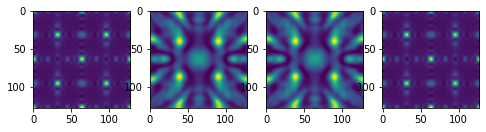

305
Log loss is:  0.290985729949934
Input RMS is:  0.009918162634716381


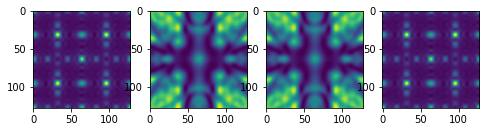

306
Log loss is:  302.59631358123715
Input RMS is:  2.5510076058234925


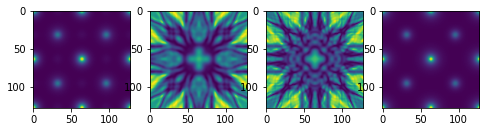

307
Log loss is:  18.238738508485962
Input RMS is:  1.43732430982982


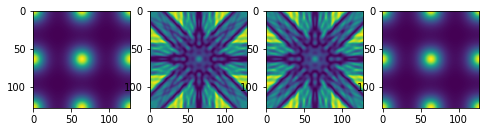

308
Log loss is:  650.8674401605108
Input RMS is:  0.7918456356206671


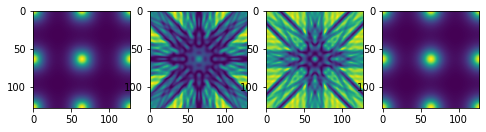

309
Log loss is:  297.556764642293
Input RMS is:  4.825195503363825


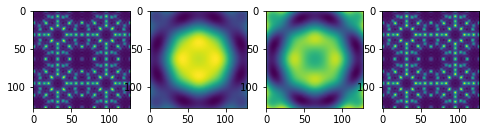

310
Log loss is:  78.18193160103164
Input RMS is:  30.806111274629764


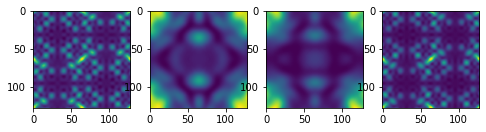

311
Log loss is:  0.505025802889428
Input RMS is:  8.702282085202026e-05


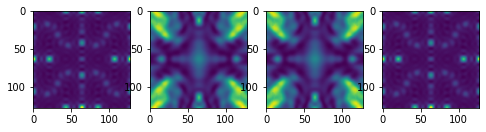

312
Log loss is:  3.0633913080955293
Input RMS is:  0.5250036598781681


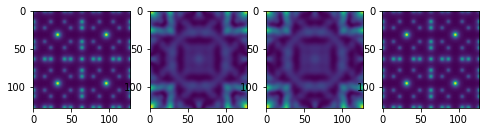

313
Log loss is:  0.040687094112607125
Input RMS is:  0.0023560997395802572


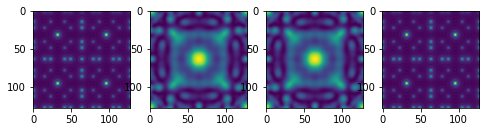

314
Log loss is:  0.051242837133728125
Input RMS is:  0.0005697504115931445


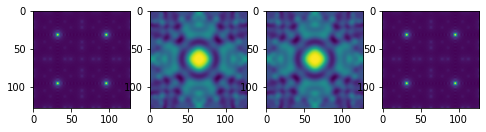

315
Log loss is:  0.08743508192080704
Input RMS is:  0.00117600048365195


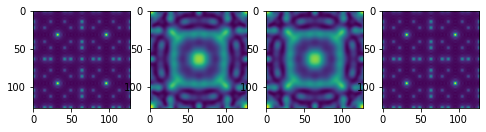

317
Log loss is:  1410.0847993991686
Input RMS is:  46.22292695896564


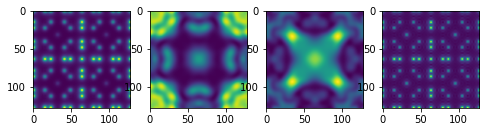

318
Log loss is:  0.06399188605654457
Input RMS is:  0.0005662915394603231


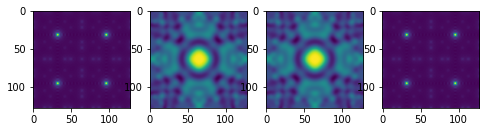

319
Log loss is:  20.23724599646559
Input RMS is:  0.048278146171973076


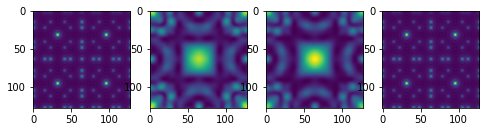

320
Log loss is:  0.7436934396920541
Input RMS is:  0.13343645036409996


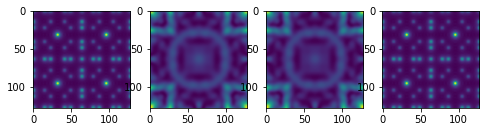

321
Log loss is:  0.35145838338337543
Input RMS is:  0.03401777644934616


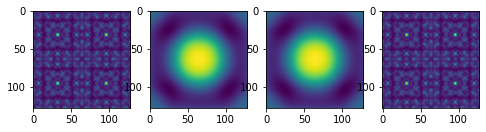

322
Log loss is:  4.515142277650405
Input RMS is:  0.4438986168971932


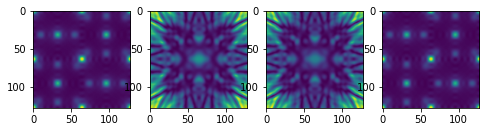

323
Log loss is:  3.8557989425515506
Input RMS is:  0.23311237481195002


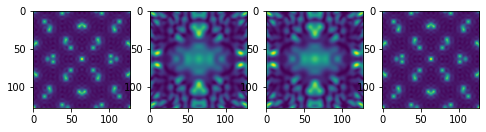

324
Log loss is:  7.8620653144662755
Input RMS is:  1.0497615096820367


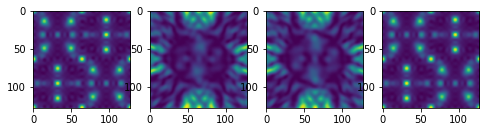

325
Log loss is:  64.12761378189619
Input RMS is:  7.963008694088751


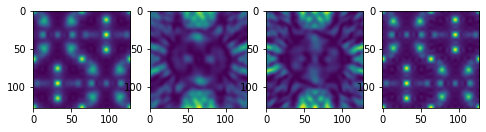

326
Log loss is:  740.2872775407208
Input RMS is:  15.738312273110298


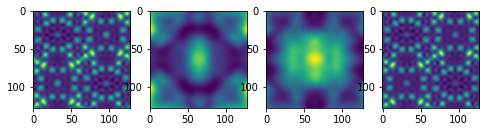

327
Log loss is:  49.356750788314585
Input RMS is:  0.6612298369675716


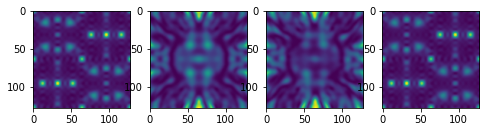

328
Log loss is:  636.0677704942212
Input RMS is:  22.240934251084777


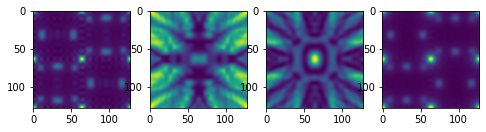

329
Log loss is:  501.16920935754956
Input RMS is:  13.74314830158075


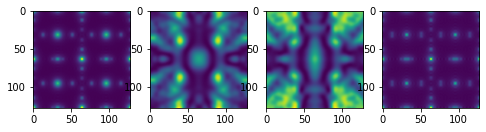

330
Log loss is:  44.46956701909398
Input RMS is:  1.6050530193904766


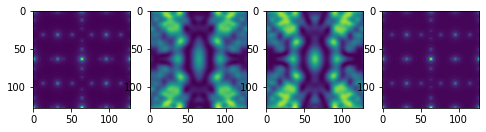

331
Log loss is:  165.35917039521294
Input RMS is:  4.02478070821668


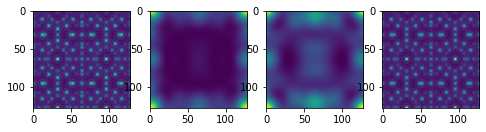

332
Log loss is:  1.9577942422485632
Input RMS is:  1.2448808948247099


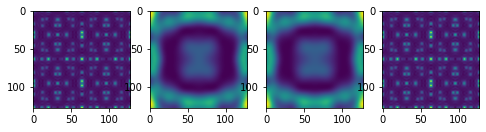

333
Log loss is:  3.7338037190923155
Input RMS is:  6.977491475260464


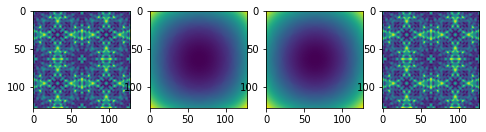

334
Log loss is:  15.15943676808906
Input RMS is:  0.09534115376200791


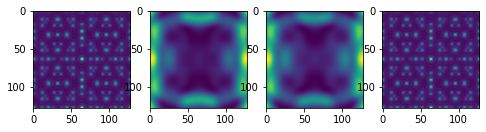

335
Log loss is:  221.03878071579936
Input RMS is:  5.337341496781568


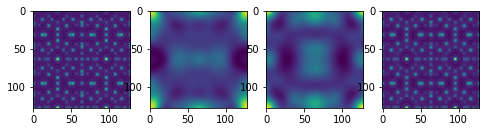

337
Log loss is:  1.6726510881912595
Input RMS is:  13.263847370664532


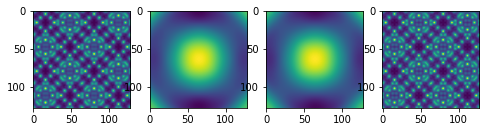

338
Log loss is:  32.067769158654734
Input RMS is:  18.690042802303687


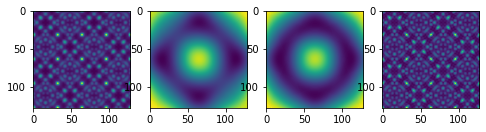

339
Log loss is:  113.70286240262051
Input RMS is:  17.010786919256528


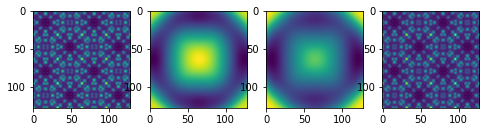

340
Log loss is:  233.6861582907349
Input RMS is:  28.671203122816237


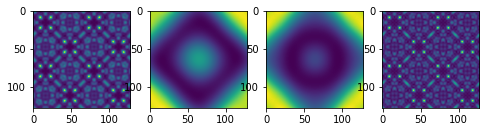

341
Log loss is:  219.4971103197364
Input RMS is:  10.804274830561123


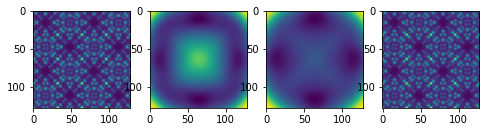

Average loss:  143.42356890047404


In [64]:
average_loss = 0
#data[0][0], data[0][1]
Rms_losses = []
reconstruction_losses = []

for i in range(0, len(All_Images[2])):
    x = All_Images[2][i][0]
    y = All_Images[2][i][1]
    #x = np.load(data[0][i])
    #y = np.load(data[1][i])
    a = All_Images[0][BestPairTrainTest[i]][1]
    b = All_Images[0][BestPairTrainTest[i]][0]
    Input_RMS = MeanSquareLogError(x, b)
    Rms_losses.append(Input_RMS)
    #print(i)
    log_loss = 0
    for j in range(0, a.shape[0]):
        for k in range(0, a.shape[1]):
            log_loss+=(math.log(1+a[j][k]) - math.log(1+y[j][k])) ** 2
    reconstruction_losses.append(log_loss)
    average_loss+=log_loss
    if Input_RMS < 50:
        print(i)
        print("Log loss is: ", log_loss)
        print("Input RMS is: ", Input_RMS)
        w=10
        h=10
        fig=plt.figure(figsize=(8, 8))
        columns = 4
        rows = 1
        fig.add_subplot(rows, columns, 1)
        plt.imshow(x)
        fig.add_subplot(rows, columns, 2)
        plt.imshow(y)
        fig.add_subplot(rows, columns, 3)
        plt.imshow(a)
        fig.add_subplot(rows, columns, 4)
        plt.imshow(b)
        plt.show()
print("Average loss: ", average_loss / len(All_Images[2]))

(array([18.,  1.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  1.]),
 array([  0.  ,  14.85,  29.7 ,  44.55,  59.4 ,  74.25,  89.1 , 103.95,
        118.8 , 133.65, 148.5 , 163.35, 178.2 , 193.05, 207.9 , 222.75,
        237.6 , 252.45, 267.3 , 282.15, 297.  ], dtype=float32),
 <BarContainer object of 20 artists>)

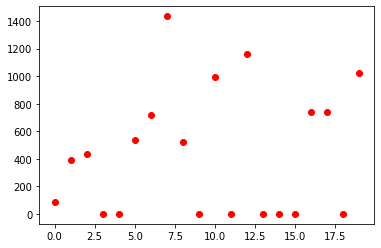

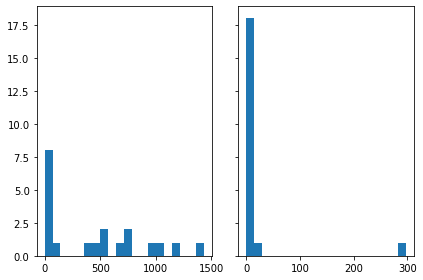

In [59]:
#plt.plot(Rms_losses, reconstruction_losses, 'o', color='black')

min_rms = min(Rms_losses)
max_rms = max(Rms_losses)
n_bins = 20

Hist_Loss = np.zeros(n_bins, dtype = np.float32)
Hist_Freq = np.zeros(n_bins, dtype = np.float32)

for i in range(0, len(Rms_losses)):
    j = math.floor((n_bins - 1) * (Rms_losses[i] - min_rms) / (max_rms - min_rms))
    Hist_Freq[j]+=1
    Hist_Loss[j]+=reconstruction_losses[i]

for i in range(0, len(Hist_Freq)):
    if(Hist_Freq[i] != 0):
        Hist_Loss[i] = Hist_Loss[i] / Hist_Freq[i]

x_range = np.arange(n_bins)

plt.plot(x_range, Hist_Loss, 'o', color='red')


fig, axs = plt.subplots(1, 2, sharey=True, tight_layout=True)


axs[0].hist(Hist_Loss, bins=n_bins)
axs[1].hist(Hist_Freq, bins=n_bins)